# MD004 ENTREGA4 REGRESIÓN LINEAL 

# <font color='#3d59c6'> PARTE I </font>

Tienes un compañero de MD004 que afirma que puede predecir la nota final de la asignatura en función del tiempo que pasa jugando a videojuegos. Decides ponerlo a prueba y le preguntas por la ecuación de regresión que usaría para hacer la predicción. Te responde inmediatamente que un modelo de regresión lineal simple. Ahora, ¿cómo comprobarías si realmente comprende el modelo poniendo a prueba su conocimiento sobre regresión lineal simple?

## <font color='#3d59c6'> Desafío: Podemos predecir nuestra nota con una Regresión Lineal? </font>

Mi compañero dice que puede predecir la nota final basándonos en las horas de juego. Acepto el reto, y lo llevaremos a un caso hipotético para ver como seria en realidad. 

Ahora generaré unos datos ficticios de 500 estudiantes, (con un poco de ruido) para simular esta realidad.

Vamos a ver si su modelo $Y = \beta_0 + \beta_1 X + \epsilon$ aguanta el análisis.

In [2]:
# Primero cargamos librerias
library(ggplot2) # para realizar los gráficos
library(gridExtra) # para juntar graficos
library(reshape2) # para preparar datos

In [3]:
# Ponemos una semilla para que los datos sean siempre los mismos
set.seed(123)

n_estudiantes <- 500

# Distribución uniforme: Los estudiantes solo pueden tener de 0 a 20 horas de juego 
horas_juego <- runif(n_estudiantes, min = 0, max = 20)

# Suponemos que la nota base es un 8.5 y baja 0.3 puntos por cada hora de juego. (+ rnorm -> ruido)
notas <- 8.5 - 0.3 * horas_juego + rnorm(n_estudiantes, mean = 0, sd = 1)
notas <- pmin(pmax(notas, 0), 10)

datos <- data.frame(Horas = horas_juego, Nota = notas)

In [4]:
head(datos)

,Horas,Nota
,<dbl>,<dbl>
1,5.751550,6.398932
2,15.766103,3.208293
3,8.179538,5.702221
4,17.660348,3.292392
5,18.809346,4.455705
6,0.911130,8.138096


In [5]:
summary(datos)

     Horas                Nota        
 Min.   : 0.009307   Min.   : 0.3317  
 1st Qu.: 4.919934   1st Qu.: 4.1517  
 Median : 9.531125   Median : 5.5357  
 Mean   : 9.905674   Mean   : 5.5484  
 3rd Qu.:14.657950   3rd Qu.: 7.0268  
 Max.   :19.988091   Max.   :10.0000  

La generación ha sido un éxito

Ahora procedemos a crear el diagrama de dispersión de los datos:

### <font color='#3d59c6'> Diagrama de dispersión </font>

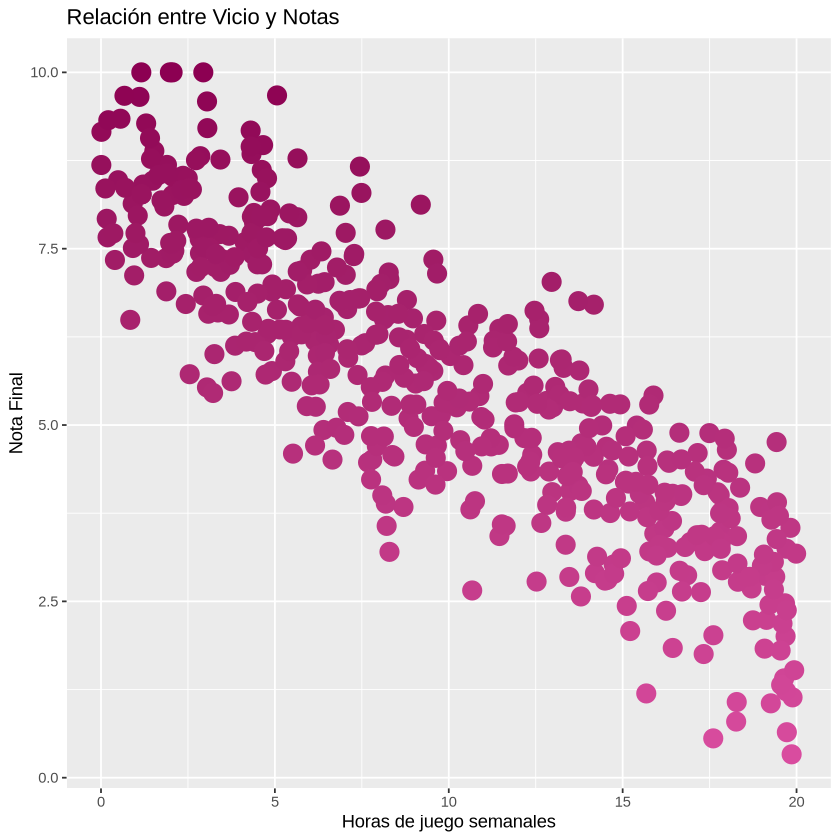

In [6]:
ggplot(datos) +  
  aes(x = Horas
      ,y = Nota
      ,color = Nota) +
  geom_point(size = 5
             ,show.legend = FALSE) +
  scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
  labs(title = "Relación entre Vicio y Notas",
       x = "Horas de juego semanales",
       y = "Nota Final")

### <font color='#3d59c6'> Análisis Visual </font> 

Al observar el gráfico de dispersión podemos plantear las primeras hipótesis para nuestro compañero:

1.  Los puntos descienden de izquierda a derecha, lo que sugiere una correlación negativa.
    * Cosa que ya esperavamos porqué el coeficiente $\beta_1$ de tu modelo tiene que ser, en efecto, negativo.

2.  La nube de puntos parece seguir un camino recto, no una curva.
    * La linealidad parece cumplirse visualmente, por lo que de momento intentar un Modelo de Regresión Lineal Simple es, en principio, una decisión correcta.

3.  Los puntos no forman una línea perfecta; hay dispersión alrededor de la tendencia central.
    * El $R^2$ no será perfecto. La cosa és si será lo suficientemente alto para considerar que su modelo es útil.

A mi compañero viendo solo la gráfica le diría si cree que la correlación ($r$) es fuerte (cerca de -1), moderada (cerca de -0.5) o débil?

### <font color='#3d59c6'> Coeficiente de correlación </font> 

In [7]:
correlacion <- cor(datos$Horas, datos$Nota)

cat("El coeficiente de correlación es:", round(correlacion, 3), "\n")

El coeficiente de correlación es: -0.86 


El valor de -0,86 indica que la asociación lineal negativa és muy fuerte. 
* Confirmamos su intuición, que a más horas, menor nota.
* Y al estar tan cerca de -1, los puntos están muy pegados a la línea imaginaria.

Ahora que nuestro modelo tiene buena pinta, tenemos que comprobar otras cosas, la correlación alta no es suficiente. 
Le preguntaria que haria él ahora.

### <font color='#3d59c6'> Calculamos coeficientes</font>

Para comprovar si el modelo es correcto debemos calcular los coeficientes para verificar su validez.

In [8]:
modelo <- lm(Nota ~ Horas, data = datos)

print(summary(modelo))

coeficientes <- coef(modelo)
b0 <- round(coeficientes[1], 2) 
b1 <- round(coeficientes[2], 2) 

cat("La ecuación del modelo és:\n")
cat("Nota Estimada =", b0, "+ (", b1, ") * Horas_Juego\n")


Call:
lm(formula = Nota ~ Horas, data = datos)

Residuals:
     Min       1Q   Median       3Q      Max 
-2.82574 -0.61762  0.03448  0.69437  2.68408 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  8.494576   0.090117   94.26   <2e-16 ***
Horas       -0.297421   0.007891  -37.69   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.003 on 498 degrees of freedom
Multiple R-squared:  0.7404,	Adjusted R-squared:  0.7399 
F-statistic:  1421 on 1 and 498 DF,  p-value: < 2.2e-16

La ecuación del modelo és:
Nota Estimada = 8.49 + ( -0.3 ) * Horas_Juego


### <font color='#3d59c6'> Resultados</font>
Los números son muy claros:

1.  Intercept ($\beta_0 = 8,49$):
    * Esto nos dice que el modelo predice que un estudiante que dedique 0 horas a los videojuegos obtendrá, en promedio, una nota de 8,49.
    * Lo qual seria un valor lógico, representa a un alumno dedicado exclusivamente al estudio.

2.  Pendiente ($\beta_1 = -0.30$):
    * Esto nos dice que por cada hora adicional que se juega a la semana, la nota final disminuye en promedio 0.30 puntos.
    * Esto valida tu hipótesis. Si juego 10 horas a la semana, el modelo predice que mi nota bajará 3 puntos ($10 \times -0.30$). Pasaría de un 8.5 (con 0 horas jugadas) a un 5,5 (10 horas jugadas).

3.  Bondad de Ajuste ($R^2 = 0.74$):
    * Este valor es increíblemente alto para un estudio de comportamiento humano. Significa que el 74% de las variaciones en las notas se explican exclusivamente por el tiempo de juego.
    * El modelo en teoria es muy fiable dentro del rango estudiado.

4.  Significancia (P-valor < 2.2e-16):
    * Al ser un valor minúsculo (mucho menor que 0.05), rechazamos la hipótesis nula. La relación entre jugar y la nota no es casualidad, es estadísticamente muy significativa. Por lo tanto tienes razón. 

### <font color='#3d59c6'> Regresión Lineal</font>

`geom_smooth()` using formula = 'y ~ x'


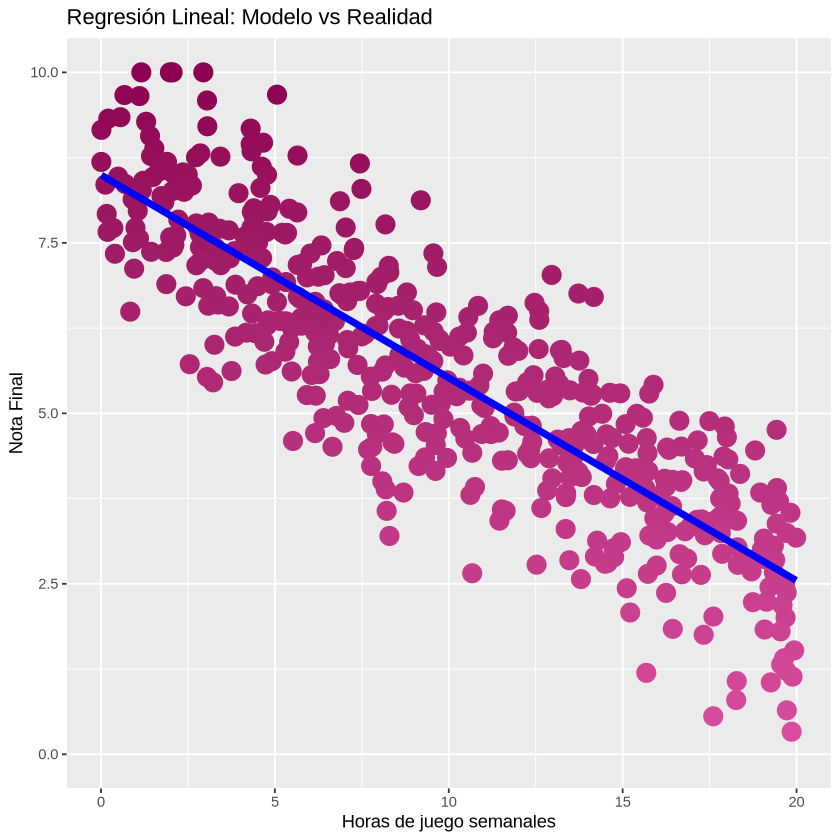

In [9]:
ggplot(datos) +
  aes(x = Horas, y = Nota) +

  geom_point(aes(color = Nota), size = 5, show.legend = FALSE) +
  scale_color_gradient(low = "#d94c9f", high = "#8c0052") +

  geom_smooth(method = "lm", color = "blue", linewidth = 2, se = FALSE) +

  labs(title = "Regresión Lineal: Modelo vs Realidad",
       x = "Horas de juego semanales",
       y = "Nota Final") +
  ylim(0, 10) 

Aquí confirmamos como hemos dicho antes la linia recta negativa

### <font color='#3d59c6'> Validación final 1</font>

Para validar científicamente el modelo, debemos analizar 4 cosas importantes, 4 gráficos clave:

1. Residuals vs Fitted 
* Aquí queremos comprobar la Linealidad que hemos visto y comprobado mirando que realmente no haya patrones extraños.
* Lo ideal seria ver una nube de puntos sin forma y una línea roja horizontal cerca del 0.


2. Normal Q-Q **(El más importante)**
* Aquí queremos comprobar la Normalidad, ver si nuestros errores siguen una Distribución Normal (Campana de Gauss).
* Lo ideal seria que los puntos sigan una línea diagonal.

3. Scale-Location 
* Aquí queremos comprobar la Homocedasticidad, que és la igualdad de varianza. Queremos saber si el error es (o no lo és) igual constante a lo largo de todo el modelo.
* Lo idea seria una línea horizontal y tener los puntos dispersos rectangularmente. Lo que no queremos ver són errores pequeños al principio y gigantes al final.

4. Residuals vs Leverage (Abajo-Derecha)
* En este gráfico final queremos detectar Outliers, que ellos solos tuercen la recta de regresión.
* Lo ideal seria no ver ningún punto fuera de las líneas punteadas de las esquinas (Distancia de Cook).

Warning message:
“Using `size` aesthetic for lines was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` instead.”
`geom_smooth()` using method = 'loess' and formula = 'y ~ x'
`geom_smooth()` using method = 'loess' and formula = 'y ~ x'
`geom_smooth()` using method = 'loess' and formula = 'y ~ x'


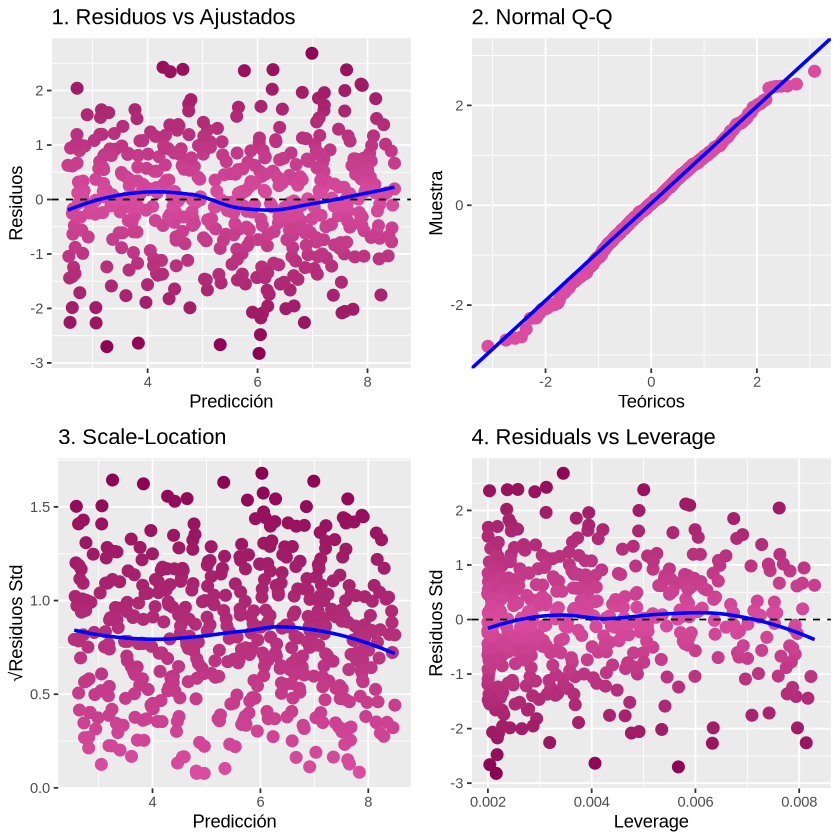

In [10]:
modelo <- lm(Nota ~ Horas, data = datos)
datos$prediccion    <- predict(modelo)
datos$residuos      <- residuals(modelo)
datos$std_residuos  <- rstandard(modelo)
datos$raiz_residuos <- sqrt(abs(datos$std_residuos))
datos$leverage      <- hatvalues(modelo)


# Gráfico 1: Residuals vs Fitted
p1 <- ggplot(datos, aes(x = prediccion, y = residuos)) +
  geom_point(aes(color = abs(residuos)), size = 3, show.legend = FALSE) + 
  geom_hline(yintercept = 0, linetype = "dashed") +
  geom_smooth(se = FALSE, color = "blue", size = 1) +
  scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
  labs(title = "1. Residuos vs Ajustados", x = "Predicción", y = "Residuos")

# Gráfico 2: Q-Q Plot
p2 <- ggplot(datos, aes(sample = residuos)) +
  geom_qq(size = 3, color = "#d94c9f") +
  geom_qq_line(color = "blue", size = 1) +
  labs(title = "2. Normal Q-Q", x = "Teóricos", y = "Muestra")

# Gráfico 3: Scale-Location
p3 <- ggplot(datos, aes(x = prediccion, y = raiz_residuos)) +
  geom_point(aes(color = raiz_residuos), size = 3, show.legend = FALSE) +
  geom_smooth(se = FALSE, color = "blue", size = 1) +
  scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
  labs(title = "3. Scale-Location", x = "Predicción", y = "√Residuos Std")

# Gráfico 4: Residuals vs Leverage
p4 <- ggplot(datos, aes(x = leverage, y = std_residuos)) +
  geom_point(aes(color = abs(std_residuos)), size = 3, show.legend = FALSE) +
  geom_hline(yintercept = 0, linetype = "dashed") +
  geom_smooth(se = FALSE, color = "blue", size = 1) +
  scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
  labs(title = "4. Residuals vs Leverage", x = "Leverage", y = "Residuos Std")

grid.arrange(p1, p2, p3, p4, ncol = 2)

### <font color='#3d59c6'> Resultados validación final 1</font>

1. Residuals vs Fitted 
    * No vemos formas de "U" (que nos indicaria que deberíamos usar una curva (x²) y no una recta).
    * Los puntos están dispersos aleatoriamente arriba y abajo, Lo importante es que no hay estructura y la pequeña ondulación es ruido aleatorio.
    * La relación es lineal. Perfecto.

2. Normal Q-Q 
    * El ajuste es perfecto. Los puntos se pegan a la línea como imanes en todo el grafico, incluso en los extremos.
    * Los errores son normales. Esto valida los p-valores y los intervalos de confianza que calculamos antes.

3. Scale-Location 
    * La línea es razonablemente plana. No hay una tendencia clara de que el error aumente o disminuya drásticamente según las horas jugadas.
    * *Se cumple el supuesto de varianza constante. El modelo predice igual de bien (o igual de mal) para los que juegan poco que para los que juegan mucho.

4. Residuals vs Leverage
    * Si nos fijamos en el valor maximo de Leverage, es muy bajo (0,008). Para que un punto sea peligroso, suele necesitar mucho más leverage y un residuo alto.
    * Al no aparecer las líneas de peligro, significa que ningún estudiante tiene el poder suficiente para mover la recta de regresión él solo. El modelo es democrático: todos los puntos pesan más o menos igual.

### <font color='#3d59c6'> Validación final 2</font>

Ahora parece todo perfecto, pero quiero enseñar a mi compañero un problema con este modelo:

In [11]:
horas_negativas <- data.frame(Horas = -5)
pred_negativa <- predict(modelo, newdata = horas_negativas)

cat("1. Si juego -5 horas, mi nota sería:", round(pred_negativa, 2), "\n")

horas_streamer <- data.frame(Horas = 40)
pred_streamer <- predict(modelo, newdata = horas_streamer)

cat("2. Si juego 40 horas a la semana, mi nota sería:", round(pred_streamer, 2), "\n")
coefs <- coef(modelo)
horas_para_cero <- -coefs[1] / coefs[2]

cat("3. Para sacar un 0 pelado, tendría que jugar:", round(horas_para_cero, 2), "horas.\n")
nuevas_horas <- data.frame(Horas = 25)
prediccion <- predict(modelo, newdata = nuevas_horas)

1. Si juego -5 horas, mi nota sería: 9.98 
2. Si juego 40 horas a la semana, mi nota sería: -3.4 
3. Para sacar un 0 pelado, tendría que jugar: 28.56 horas.


### <font color='#3d59c6'> Resultados validación final 2 (Reductio ad Absurdum)</font>

Para confirmar que no podemos confiar ciegamente en la fórmula matemática, he realizado cuatro pruebas para que veas que pasa:

1. Jugar horas negativas
* El modelo predice una nota de 9.98.
* El dominio de la variable X debe ser positivo. Además, la variable Y (Nota) suele estar acotada a 10. La Regresión Lineal no entiende de "topes" o límites naturales a menos que nosotros se los pongamos.

2. Notas negativas
* Al jugar 40 horas (que es físicamente posible en una semana), el modelo predice una nota negativa -3.4.
* En la vida real, lo peor que puedes sacar es un 0. La relación lineal deja de funcionar cuando nos alejamos mucho de los datos originales (0-20 horas). Probablemente, a partir de cierto punto, la nota se estanca en 0 y deja de bajar, rompiendo la linealidad.

3. El punto de corte (Intercepto en X):
* El modelo dice que con 28.56 horas de juego, la nota llega a 0.
* Este es el único dato extremo que podría tener algo de sentido. Nos marca el "límite de seguridad" teórico antes del suspenso total absoluto.

Conclusión General:
El modelo es útil y válido SOLO dentro del rango de datos observados (interpolación). Usarlo para extrapolar situaciones extremas lleva a errores graves de lógica.

### <font color='#3d59c6'> Comprobamos validación final 2: Mapa de Riesgos</font>

Para visualizar por qué no debemos confiar ciegamente en la fórmula, hemos extendido el gráfico más allá de la realidad (desde -5 hasta 45 horas).

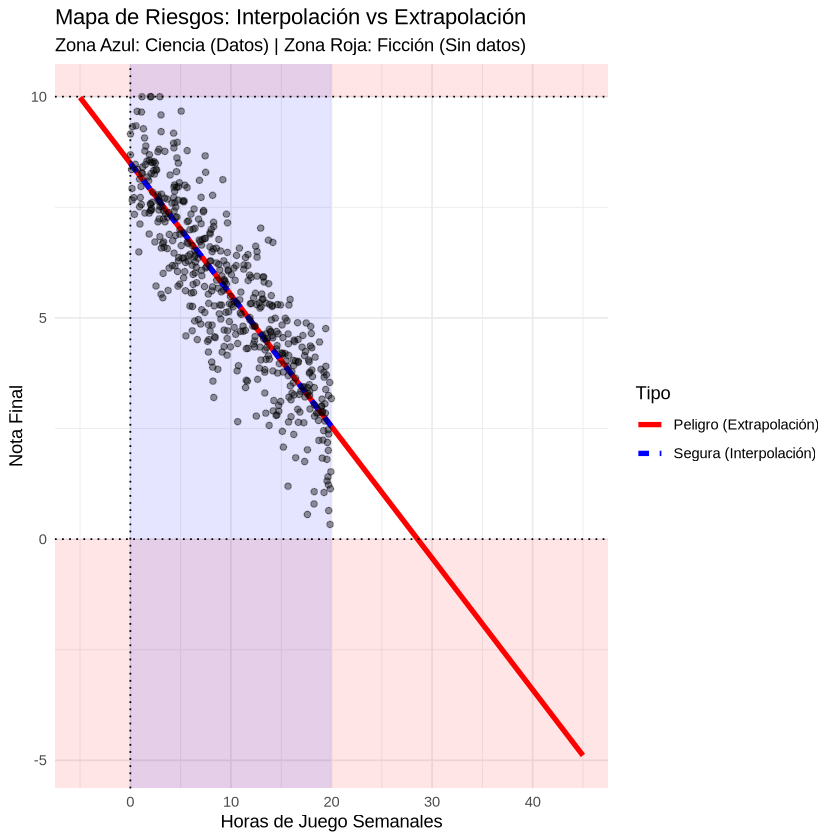

In [12]:
rango_extendido <- data.frame(Horas = seq(-5, 45, by = 1))
rango_extendido$Nota <- predict(modelo, newdata = rango_extendido)
rango_extendido$Tipo <- ifelse(rango_extendido$Horas >= 0 & rango_extendido$Horas <= 20, 
                               "Segura (Interpolación)", "Peligro (Extrapolación)")

ggplot() +
  annotate("rect", xmin = -Inf, xmax = Inf, ymin = 10, ymax = Inf, fill = "red", alpha = 0.1) +
  annotate("rect", xmin = -Inf, xmax = Inf, ymin = -Inf, ymax = 0, fill = "red", alpha = 0.1) +
  
  annotate("rect", xmin = 0, xmax = 20, ymin = -Inf, ymax = Inf, fill = "blue", alpha = 0.1) +
  
  geom_line(data = rango_extendido, aes(x = Horas, y = Nota, linetype = Tipo, color = Tipo), size = 1.5) +
  geom_point(data = datos, aes(x = Horas, y = Nota), alpha = 0.4) +
  
  geom_vline(xintercept = 0, linetype = "dotted") + 
  geom_hline(yintercept = 0, linetype = "dotted") + 
  geom_hline(yintercept = 10, linetype = "dotted") + 
  
  scale_color_manual(values = c("red", "blue")) +
  labs(title = "Mapa de Riesgos: Interpolación vs Extrapolación",
       subtitle = "Zona Azul: Ciencia (Datos) | Zona Roja: Ficción (Sin datos)",
       y = "Nota Final", x = "Horas de Juego Semanales") +
  theme_minimal()

1. Zona Azul vs. Zona Roja:

  * Interpolación (0-20h): La zona segura (Azul). Aquí tenemos datos reales y el modelo es fiable.
  * Extrapolación (Resto): La zona de peligro (Roja). Aquí el modelo vuela a ciegas sin datos que lo respalden.

Los puntos (los datos reales) saben que existen esos límites porque se los pusimos. Pero la línea roja, el modelo matemático, NO lo sabe. La ecuación $Y = 8.49 - 0.3X$ es como es. Ella sigue restando indefinidamente hasta el infinito negativo.Por eso el gráfico es tan potente: se ven cómo los puntos se frenan en el 10 y el 0, pero la línea roja se estrella y sigue bajando.

**Conclusión:**
El modelo funciona de maravilla dentro de su rango, pero no tiene sentido común fuera de él.

## <font color='#3d59c6'> Finalmente desafías a tu compañero a mejorar su modelo y le pides que considere agregar otra variable predictora: "la cantidad de horas dedicadas al estudio". ¿qué argumentos en contra o a favor te podría dar? ¿cómo podrías evaluar si la nueva variable realmente mejora la capacidad predictiva del modelo?</font>

Argumentos de por qué debería mejorar:
1.  Lógica: Estudiar afecta a la nota más directamente que jugar.
2.  Reducción del Sesgo: Es probable que "Jugar mucho" sea solo un indicador de "Estudiar poco". Si no incluimos el estudio, estamos culpando a los videojuegos de algo que en realidad es culpa de no abrir el libro.
3.  Reducción del Error: Al explicar más variabilidad, los residuos ($\epsilon$) deberían hacerse más pequeños.

Argumentos de riesgo técnico:
1.  El problema de la Multicolinealidad: El tiempo es finito. Si juego 5 horas más, probablemente estudio 5 horas menos. Si las dos variables están muy correlacionadas entre sí (son redundantes), el modelo matemático no funcionará. Los coeficientes pueden volverse locos y perder significancia individual, aunque el modelo global prediga bien.
2.  Complejidad: Un modelo con menos variables suele ser preferible si la mejora en predicción es marginal.

Cómo lo podemos comprobar?
No podemos mirar el $R^2$ normal (porque siempre sube al añadir variables, aunque sean basura). Debemos mirar:
* $R^2$ Ajustado: Penaliza si se añaden variables inútiles.
* Test ANOVA: Compara si la reducción de error compensa la complejidad extra.

### <font color='#3d59c6'> Simulamos</font>

Como no, procederemos a simular otra vez como ya hemos hecho para ver que pasaria en un caso real.

Ahora generamos la nueva variable "Horas de Estudio" y asumiremos que quien juega mucho, estudia poco (correlación negativa)

In [13]:
set.seed(123)
datos$Estudio <- pmax(0, 25 - datos$Horas + rnorm(n_estudiantes, mean=0, sd=3))

head(datos)

modelo2 <- lm(Nota ~ Horas + Estudio, data = datos)

summary(modelo2)

,Horas,Nota,prediccion,residuos,std_residuos,raiz_residuos,leverage,Estudio
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,5.751550,6.398932,6.783945,-0.38501256,-0.38455572,0.6201256,0.003068740,17.567023
2,15.766103,3.208293,3.805408,-0.59711483,-0.59672313,0.7724786,0.004127023,8.543365
3,8.179538,5.702221,6.061810,-0.35958900,-0.35900317,0.5991687,0.002184528,21.496587
4,17.660348,3.292392,3.242020,0.05037269,0.05038006,0.2244550,0.005724264,7.551177
5,18.809346,4.455705,2.900284,1.55542140,1.55657728,1.2476287,0.006909662,6.578518
6,0.911130,8.138096,8.223587,-0.08549075,-0.08555862,0.2925040,0.007010391,29.234065



Call:
lm(formula = Nota ~ Horas + Estudio, data = datos)

Residuals:
     Min       1Q   Median       3Q      Max 
-2.82207 -0.62207  0.03628  0.69460  2.68476 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  8.548533   0.401836  21.274   <2e-16 ***
Horas       -0.299602   0.017693 -16.934   <2e-16 ***
Estudio     -0.002128   0.015444  -0.138     0.89    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.004 on 497 degrees of freedom
Multiple R-squared:  0.7404,	Adjusted R-squared:  0.7394 
F-statistic: 708.9 on 2 and 497 DF,  p-value: < 2.2e-16


### <font color='#3d59c6'> Analizamos modelo múltiple</font>

Hemos añadido la variable Estudio esperando mejorar la predicción, pero los datos nos dicen lo contrario:

1. La variable "Estudio" NO es significativa:
  * Si miramos la columna Pr(>|t|) para la variable Estudio, su valor és 0,89.
  * Es un valor altísimo (mucho mayor que 0.05). No podemos rechazar la hipótesis nula. Estadísticamente, añadir las horas de estudio es ruido puro una vez que ya sabemos cuántas horas juega.

2. El extraño caso del coeficiente:
  * El coeficiente de estudio es -0.002. Esto valor al ser tan cercano a cero es despreciable.
  * Esto nos dice que és un síntoma claro de Multicolinealidad. Como generamos los datos asumiendo que el tiempo es limitado (si juego mucho, estudio poco), la variable "Horas de juego" ya captura casi toda la información, dejando a "Estudio" sin nada que explicar.


### <font color='#3d59c6'> VIF y Mapa de Calor</font>

Para no basarnos solo en suposiciones, necesitamos pruebas forenses que confirmen esta Multicolinealidad (redundancia entre variables). 
Vamos a aplicar dos diagnósticos clave:

1.  Factor de Inflación de la Varianza (VIF):**
      * Necesitamos ponerle un número a la gravedad del problema.
      * Si obtenemos un VIF > 5, tendremos la justificación estadística definitiva para descartar la variable nueva, ya que confirma que está "inflando" el error y desestabilizando el modelo.
        
2.  Mapa de Calor (Matriz de Correlación):**
      * Queremos ver visualmente si "Horas" y "Estudio" tienen una correlación extremadamente alta (cercana a -1). Si es así, significa que son "espejos": la una aporta la misma información que la otra, pero invertida.

In [14]:
modelo_auxiliar <- lm(Horas ~ Estudio, data = datos)

r2_aux <- summary(modelo_auxiliar)$r.squared

vif_manual <- 1 / (1 - r2_aux)

cat("El VIF calculado es:", round(vif_manual, 2), "\n")

El VIF calculado es: 5.02 


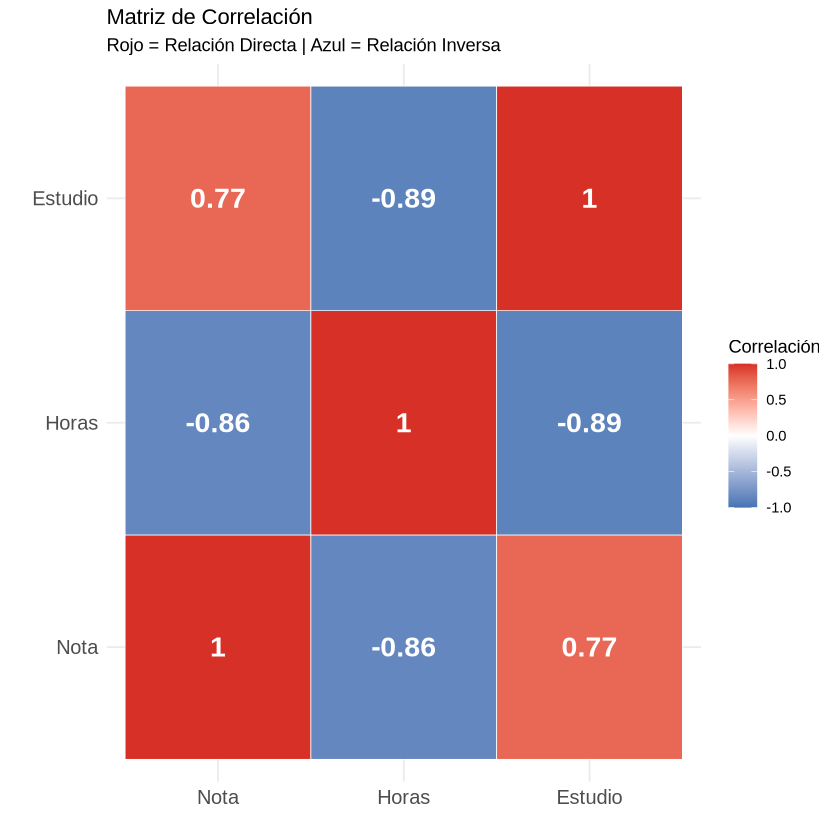

In [15]:
cormat <- round(cor(datos[, c("Nota", "Horas", "Estudio")]), 2)
melted_cormat <- melt(cormat)

ggplot(data = melted_cormat, aes(x=Var1, y=Var2, fill=value)) + 
  geom_tile(color = "white") + 
  
  geom_text(aes(label = value), color = "white", size = 6, fontface = "bold") +
  
  scale_fill_gradient2(low = "#4575b4", high = "#d73027", mid = "white", 
                       midpoint = 0, limit = c(-1,1),
                       name = "Correlación") +
  
  labs(title = "Matriz de Correlación", 
       subtitle = "Rojo = Relación Directa | Azul = Relación Inversa",
       x="", y="") +
  
  theme_minimal() +
  theme(axis.text = element_text(size = 12))

### <font color='#3d59c6'> Veredicto</font>

1. El VIF de 5.02 
El Factor de Inflación de la Varianza nos da la sentencia numérica. En ciencia de datos se usa:
  * VIF igual a 1: Ideal. Las variables son independientes.
  * VIF mayor que 5: Zona de riesgo. Existe multicolinealidad problemática.
  * VIF mayor que 10: Error grave. El modelo es inservible.
Nuestro cálculo manual ha dado 5.02. Hemos cruzado la línea roja del 5. Aunque sea por poco, esto nos da la justificación científica para aplicar la Navaja de Ockham: debemos cortar la variable "Estudio".

2. El Mapa de Calor
Nos tenemos que fijar en los cuadrados donde se cruzan la fila "Horas" con la columna "Estudio".
  * Tienen un valor de -0.89.
  * Este número indica una correlación negativa muy fuerte. Significa que las dos variables son prácticamente imágenes especulares: cuando las horas de juego suben, las de estudio bajan casi con exactitud matemática.
  * El problema: Al darle esto al ordenador, no le estamos dando información nueva. Es como contarle la misma historia dos veces pero cambiando las palabras. El modelo se confunde porque no sabe a quién atribuir el mérito de la nota.

### <font color='#3d59c6'> Test ANOVA</font>
Ahora procederemos a comparar si la reducción de error compensa la complejidad extra con el test ANOVA.

In [16]:
anova_comparacion <- anova(modelo, modelo2)
print(anova_comparacion)

Analysis of Variance Table

Model 1: Nota ~ Horas
Model 2: Nota ~ Horas + Estudio
  Res.Df    RSS Df Sum of Sq     F Pr(>F)
1    498 500.72                          
2    497 500.70  1  0.019129 0.019 0.8905


  * El test ANOVA compara el Modelo 1 vs Modelo 2.
  * El P-valor es 0.8905.
  * No hay diferencia significativa. El modelo complejo no es mejor que el simple.

### <font color='#3d59c6'> Conclusiones</font>

Tras someter a prueba la afirmación de mi compañero ("el tiempo de juego predice la nota final") mediante un análisis estadístico riguroso, hemos llegado a las siguientes conclusiones:

1.  La relación es real y cuantificable
  * Existe una evidencia estadística muy fuerte (p-value \< 0.05 y r ≈ -0.86) de que jugar a videojuegos está asociado negativamente con la nota final.
  * El modelo de Regresión Lineal Simple seleccionado es:
    $$\text{Nota} = 8.49 - 0.30 \times (\text{Horas de Juego})$$
  * Esto implica que, por cada hora semanal dedicada a jugar, el estudiante sacrifica aproximadamente 0.30 puntos de su nota final.

2.  Validez y Robustez del Modelo:
  * El análisis de residuos ha confirmado que el modelo es técnico y estadísticamente válido:
  * Los errores siguen una distribución Normal.
  * Existe Homocedasticidad (la varianza del error es constante).
  * No hay Outliers peligrosos que distorsionen la realidad.

3.  Límites del Modelo (Lección de Extrapolación):
  * Hemos demostrado que las ecuaciones matemáticas no tienen sentido común por sí mismas. Al intentar predecir la nota para -5 horas (viaje en el tiempo) o 40 horas semanales (nota negativa), el modelo falló.
  * Conclusión: Este modelo solo es útil para realizar predicciones dentro del rango de datos observados (interpolación entre 0 y 20 horas).

4.  Selección del Modelo:
  * Intentamos mejorar la predicción añadiendo la variable "Horas de Estudio". Sin embargo, debido a la multicolinealidad (quien juega mucho, estudia poco), la nueva variable no aportó información significativa ni mejoró el modelo de forma relevante.
  * Siguiendo el principio de la Navaja de Ockham, nos quedamos con el modelo más sencillo: La Regresión Lineal Simple.

### <font color='#3d59c6'> Veredicto Final</font>

El compañero tenía razón en su intuición, pero ahora tenemos la validación matemática para respaldarla. El modelo lineal simple es la herramienta óptima para explicar este fenómeno, siempre y cuando se use dentro de los límites lógicos del tiempo disponible.

----

----

# <font color='#3d59c6'> PARTE II </font>

Se dispone de un dataset que contiene en formato csv datos de la población de Estados Unidos con el objetivo de generar un modelo de regresión lineal simple para predecir las tasas de mortalidad por cáncer (target_deathrate) en los condados de los Estados Unidos

###### Data: 
20241120_cancer_reg.csv

###### Se pide:

1. Exploración de los datos: análisis descriptivos de los datos y graficación comentando los resultados obtenidos(3pts)
- análisis descriptivo de la variable objetivo (métricas+gráficos) comentando los resultados
- análisis descriptivo de las variables explicativas (métricas+gráficos) comentando los resultados
- análisis bivariante entre la variable objetivo vs variable explicativa, escoged las 2 variables que a priori se observe que mejor ajustarían en un modelo de regresión lineal y justificad el porqué
   
2. Desarrollo del mejor modelo (3pts)
- generad un modelo de regresión lineal simple para cada una de las variables escogidas
- ¿qué modelo ajusta mejor?
- validad los diferentes supuestos que deben cumplir comentados en clase (¿hay alguna variable que no cumpla el criterio de homocedasticidad? ¿has detectado outliers?)
- escoge un modelo para su validación y justifica por qué?

3. Validación mediante el conjunto de Test (2pts)
- generad un gráfico de relación dato observado vs predicción
- comentad los valores R^2, RMSE, MAE
- te quedarías con este modelo?

###### Definición variables

- **avganncount** *decimal* <u>Media</u> numero de casos reportados de cancer diagnosticados de cancer al año (a)
- **avgdeathsperyear** *integer* <u>Media</u> número de muertes notificadas por cáncer (a)
- **target_deathrate** *decimal* ***Dependent variable***. <u>Media</u> muertes por cancer (100K hab.) (a)
- **incidencerate** *decimal* <u>Media</u> casos diagnosticados de cancer (100K hab.) (a)
- **medincome** *integer* <u>Mediana</u> ingresos por condado (b)
- **popest2015** *integer* población del condado (b)
- **povertypercent** *decimal* <u>%Población</u> bajo situación de pobreza (b)
- **studypercap** *decimal* Número per cápita de ensayos clínicos relacionados con el cáncer por condado (a)
- **binnedinc** *string* <u>Mediana</u> renta per cápita agrupada por decil (b)
- **medianage** *decimal* <u>Mediana</u> edad de las residentes del condado (b)
- **medianagemale** *decimal* <u>Mediana</u> edad de la población masculina condado (b)
- **medianagefemale** *decimal* <u>Mediana</u> edad de la población femenina del condado (b)
- **geography** *string* nombre del condado (b)
- **percentmarried** *decimal* <u>%Residentes del condado</u> matrimonios (b)
- **pctnohs18_24** *decimal* <u>%Residentes del condado entre 18-24 años</u> sin educación secundaria (b)
- **pcths18_24** *decimal* <u>%Residentes del condado entre 18-24 años</u> mayor grado de formación: secundaria (b)
- **pctsomecol18_24** *decimal* <u>%Residentes del condado entre 18-24 años</u> mayor grado de formación: educación superior (b)
- **pctbachdeg18_24** *decimal* <u>%Residentes del condado entre 18-24 años</u> mayor grado de formación: licenciatura (b)
- **pcths25_over** *decimal* <u>%Residentes del condado >25 años</u> mayor grado de formación: diplomatura (b)
- **pctbachdeg25_over** *decimal* <u>%Residentes del condado >25 años</u> mayor grado de formación: licenciatura (b)
- **pctemployed16_over** *decimal* <u>%Residentes del condado >16 años</u> con trabajo (b)
- **pctunemployed16_over** *decimal* <u>%Residentes del condado >16 años</u>en el paro (b)
- **pctprivatecoverage** *decimal* <u>%Residentes del condado</u> con seguro médico (b)
- **pctprivatecoveragealone** *decimal* <u>%Residentes del condado</u> solo con cobertura de salud privada (sin asistencia pública) (b)
- **pctempprivcoverage** *decimal* <u>%Residentes del condado</u> con cobertura de salud privada proporcionada por los empleados (b)
- **pctpubliccoverage** *decimal* <u>%Residentes del condado</u> con cobertura de salud proporcionada por el gobierno (b)
- **pctpubliccoveragealone** *decimal* <u>%Residentes del condado</u> solo con cobertura de salud proporcionada por el gobierno (b)
- **pctwhite** *decimal* <u>%Residentes del condado</u> población blanca (b)
- **pctblack** *decimal* <u>%Residentes del condado</u> población negra (b)
- **pctasian** *decimal* <u>%Residentes del condado</u> población asiática (b)
- **pctotherrace** *decimal* <u>%Residentes del condado</u> que se identifican en una categoría que no es blanca, negra o asiática (b)
- **pctmarriedhouseholds** *decimal* <u>Porcentaje</u> de hogares con matrimonios (b)
- **birthrate** *decimal* ratio natalidad vs mujeres en el condado (b)


In [17]:
# librerias utilizadas en esta segunda parte
library(tidyverse)
library(caret)
library(lmtest)
library(gridExtra)
library(broom)
library(ggplot2)
library(e1071)

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.3     ✔ readr     2.1.4
✔ forcats   1.0.0     ✔ stringr   1.5.0
✔ lubridate 1.9.3     ✔ tibble    3.2.1
✔ purrr     1.0.2     ✔ tidyr     1.3.0
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::combine() masks gridExtra::combine()
✖ dplyr::filter()  masks stats::filter()
✖ dplyr::lag()     masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
Loading required package: lattice


Attaching package: ‘caret’


The following object is masked from ‘package:purrr’:

    lift


Loading required package: zoo


Attaching package: ‘zoo’


The following objects are masked from ‘package:base’:

    as.Date, as.Date.numeric



Attaching package: ‘e1071’


The following object is masked from ‘package:ggplot2’:

    element




## <font color='#3d59c6'> 1. Exploración de los datos:</font>

Para iniciar la exploración de los datos primero de todo cargaremos el dataset y veremos un análisis general de este:

In [18]:
data_canc = read.csv(file='202511S4_cancer_reg.csv', header=TRUE, sep=',', dec='.')

In [19]:
head(data_canc)
tail(data_canc)

,avganncount,avgdeathsperyear,target_deathrate,incidencerate,medincome,popest2015,povertypercent,studypercap,binnedinc,medianage,⋯,pctprivatecoveragealone,pctempprivcoverage,pctpubliccoverage,pctpubliccoveragealone,pctwhite,pctblack,pctasian,pctotherrace,pctmarriedhouseholds,birthrate
,<dbl>,<int>,<dbl>,<dbl>,<int>,<int>,<dbl>,<dbl>,<chr>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,1397,469,164.9,489.8,61898,260131,11.2,499.74820,"(61494.5, 125635]",39.3,⋯,NA,41.6,32.9,14.0,81.78053,2.5947283,4.8218571,1.8434785,52.85608,6.118831
2,173,70,161.3,411.6,48127,43269,18.6,23.11123,"(48021.6, 51046.4]",33.0,⋯,53.8,43.6,31.1,15.3,89.22851,0.9691025,2.2462326,3.7413515,45.37250,4.333096
3,102,50,174.7,349.7,49348,21026,14.6,47.56016,"(48021.6, 51046.4]",45.0,⋯,43.5,34.9,42.1,21.1,90.92219,0.7396734,0.4658982,2.7473583,54.44487,3.729488
4,427,202,194.8,430.4,44243,75882,17.1,342.63725,"(42724.4, 45201]",42.8,⋯,40.3,35.0,45.3,25.0,91.74469,0.7826260,1.1613587,1.3626432,51.02151,4.603841
5,57,26,144.4,350.1,49955,10321,12.5,0.00000,"(48021.6, 51046.4]",48.3,⋯,43.9,35.1,44.0,22.7,94.10402,0.2701920,0.6658304,0.4921355,54.02746,6.796657
6,428,152,176.0,505.4,52313,61023,15.6,180.25990,"(51046.4, 54545.6]",45.4,⋯,38.8,32.6,43.2,20.2,84.88263,1.6532052,1.5380566,3.3146354,51.22036,4.964476


,avganncount,avgdeathsperyear,target_deathrate,incidencerate,medincome,popest2015,povertypercent,studypercap,binnedinc,medianage,⋯,pctprivatecoveragealone,pctempprivcoverage,pctpubliccoverage,pctpubliccoveragealone,pctwhite,pctblack,pctasian,pctotherrace,pctmarriedhouseholds,birthrate
,<dbl>,<int>,<dbl>,<dbl>,<int>,<int>,<dbl>,<dbl>,<chr>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
3042,1962.668,48,146.4,453.5494,49508,29029,13.0,723.4145,"(48021.6, 51046.4]",32.2,⋯,64.5,52.9,24.3,9.5,94.29173,1.145104,1.3865416,1.014038,43.27678,3.977583
3043,1962.668,15,149.6,453.5494,46961,6343,12.4,0.0000,"(45201, 48021.6]",44.2,⋯,54.9,44.6,31.7,13.2,90.28081,3.837754,0.3276131,1.700468,51.06383,7.773512
3044,1962.668,43,150.1,453.5494,48609,37118,18.8,377.1755,"(48021.6, 51046.4]",30.4,⋯,53.3,48.6,28.8,17.7,75.70625,2.326771,4.0449196,14.130288,52.00794,8.186470
3045,1962.668,46,153.9,453.5494,51144,34536,15.0,1968.9599,"(51046.4, 54545.6]",30.9,⋯,52.6,47.8,26.6,16.8,87.96163,2.313188,1.3164717,5.680705,55.15395,7.809192
3046,1962.668,52,175.0,453.5494,50745,25609,13.3,0.0000,"(48021.6, 51046.4]",39.0,⋯,56.3,49.6,29.5,14.0,92.90568,1.176562,0.2446317,2.131790,58.48423,7.582938
3047,1962.668,48,213.6,453.5494,41193,37030,13.9,0.0000,"(40362.7, 42724.4]",26.2,⋯,60.3,22.9,25.1,12.6,70.09813,16.590100,3.1777530,1.356457,56.04024,8.981723


In [20]:
str(data_canc) 

'data.frame':	3047 obs. of  33 variables:
 $ avganncount            : num  1397 173 102 427 57 ...
 $ avgdeathsperyear       : int  469 70 50 202 26 152 97 71 36 1380 ...
 $ target_deathrate       : num  165 161 175 195 144 ...
 $ incidencerate          : num  490 412 350 430 350 ...
 $ medincome              : int  61898 48127 49348 44243 49955 52313 37782 40189 42579 60397 ...
 $ popest2015             : int  260131 43269 21026 75882 10321 61023 41516 20848 13088 843954 ...
 $ povertypercent         : num  11.2 18.6 14.6 17.1 12.5 15.6 23.2 17.8 22.3 13.1 ...
 $ studypercap            : num  499.7 23.1 47.6 342.6 0 ...
 $ binnedinc              : chr  "(61494.5, 125635]" "(48021.6, 51046.4]" "(48021.6, 51046.4]" "(42724.4, 45201]" ...
 $ medianage              : num  39.3 33 45 42.8 48.3 45.4 42.6 51.7 49.3 35.8 ...
 $ medianagemale          : num  36.9 32.2 44 42.2 47.8 43.5 42.2 50.8 48.4 34.7 ...
 $ medianagefemale        : num  41.7 33.7 45.8 43.4 48.9 48 43.5 52.5 49.8 37 ...
 $

In [21]:
summary(data_canc)

  avganncount      avgdeathsperyear target_deathrate incidencerate   
 Min.   :    6.0   Min.   :    3    Min.   : 59.7    Min.   : 201.3  
 1st Qu.:   76.0   1st Qu.:   28    1st Qu.:161.2    1st Qu.: 420.3  
 Median :  171.0   Median :   61    Median :178.1    Median : 453.5  
 Mean   :  606.3   Mean   :  186    Mean   :178.7    Mean   : 448.3  
 3rd Qu.:  518.0   3rd Qu.:  149    3rd Qu.:195.2    3rd Qu.: 480.9  
 Max.   :38150.0   Max.   :14010    Max.   :362.8    Max.   :1206.9  
                                                                     
   medincome        popest2015       povertypercent   studypercap     
 Min.   : 22640   Min.   :     827   Min.   : 3.20   Min.   :   0.00  
 1st Qu.: 38882   1st Qu.:   11684   1st Qu.:12.15   1st Qu.:   0.00  
 Median : 45207   Median :   26643   Median :15.90   Median :   0.00  
 Mean   : 47063   Mean   :  102637   Mean   :16.88   Mean   : 155.40  
 3rd Qu.: 52492   3rd Qu.:   68671   3rd Qu.:20.40   3rd Qu.:  83.65  
 Max.   :12563

### <font color='#3d59c6'>  Análisis Descriptivo General</font>

1. Variable Objetivo (target_deathrate)
* La media (178.7) y la mediana (178.1) son casi idénticas, lo que sugiere una distribución normal.
* Va de 59.7 a 362.8. No parece haber valores imposibles (como negativos o excesivamente altos que indiquen error), aunque los valores cercanos a 362 indican zonas de muy alta mortalidad.

2. Variables de Conteo y Población (avganncount, avgdeathsperyear, popest2015)
* Estas variables tienen una asimetría positiva enorme, indican un Sesgo Extremo.
    * Por ejemplo: popest2015 tiene una mediana de 26,643 habitantes, pero un máximo de 10,170,292.
* Esto no es un error, es la naturaleza de la geografía de EE. UU. Sin embargo, estos "outliers naturales" pueden tener una influencia desproporcionada en el modelo de regresión (efecto palanca).

3. Variables Socioeconómicas (medincome, povertypercent)
* Ingresos: (medincome): Rango de 22,640  a  125,635. Parece válido.
* Pobreza: (povertypercent): Va del 3.2% al 47.4%. 

4. Variables Educativas y de Empleo
* Rangos: Todas las variables de porcentaje (pct...) parecen estar correctamente acotadas entre 0 y 100 (o cerca).
* Empleo: pctunemployed16_over llega casi al 30% en el peor caso, lo cual es alto pero posible.

### <font color='#3d59c6'>  Detección de Anomalías, Errores y Outliers</font>

He encontrado 3 problemas graves en los datos:

Valores Perdidos Masivos (NAs). Según el summary, hay variables con muchos NAs:
1.  pctsomecol18_24: Tiene 2285 NAs sobre 3047 registros.
    * Falta el 75% de la información.
    * Eliminaremos la columna entera. No sirve para modelar.
2.  pctprivatecoveragealone: Tiene 609 NAs.
    * Falta el 20% de los datos.
    * Intentariamos rellenar con la media/mediana, pero dada la cantidad, lo más seguro es no usar esta variable.
3.  pctemployed16_over: Tiene 152 NAs.
    * Al ser pocos (5%), optaremos por imputar con la mediana.

Error de Datos en medianage:
* El valor máximo de la variable medianage (edad mediana del condado) es 624.00 años.
* Es imposible. Nadie vive 600 años.
* Es un error tipográfico. Probablemente sea 62.4 o 24.0.

Outliers Estadísticos en studypercap:
* Mediana = 0.00
* 3er Quartil = 83.65
* Máximo = 9762.31
  
La inmensa mayoría de los condados (más del 50%) tienen 0 ensayos clínicos (Median: 0.00). Sin embargo, unos pocos condados tienen valores altísimos.
Esta variable tiene una distribución tan sesgada (casi todo ceros) que apenas aportará valor predictivo lineal.
Investigaremos mas a profundo esta columna.

### <font color='#3d59c6'>  Creación dataset limpio</font>

Procedemos a crear un dataset 'data_clean', con toda la información correcta y necesaria para realizar un correcto modelo posterior.

In [22]:
data_clean <- data_canc %>%
  dplyr::select(-pctsomecol18_24, -pctprivatecoveragealone)

if(!"pctsomecol18_24" %in% names(data_clean) & !"pctprivatecoveragealone" %in% names(data_clean)) {
  print("Columnas 'pctsomecol18_24' y 'pctprivatecoveragealone' eliminadas.")
} else {
  print("ERROR: Las columnas no se han borrado.")
}

nas_antes <- sum(is.na(data_clean$pctemployed16_over))
mediana_empleo <- median(data_clean$pctemployed16_over, na.rm = TRUE)

data_clean <- data_clean %>%
  mutate(pctemployed16_over = ifelse(is.na(pctemployed16_over), 
                                     mediana_empleo, 
                                     pctemployed16_over))

nas_despues <- sum(is.na(data_clean$pctemployed16_over))

cat("\nReporte imputación\n")
cat("NAs iniciales en 'pctemployed16_over':", nas_antes, "\n")
cat("Valor de la Mediana usado:", mediana_empleo, "\n")
cat("NAs finales:", nas_despues, "\n")

[1] "Columnas 'pctsomecol18_24' y 'pctprivatecoveragealone' eliminadas."

Reporte imputación
NAs iniciales en 'pctemployed16_over': 152 
Valor de la Mediana usado: 54.5 
NAs finales: 0 


In [23]:
fila_error <- which(data_clean$medianage > 100)
print(data_canc[fila_error, c("geography", "medianage")])

                               geography medianage
101              Seward County, Nebraska     458.4
182          Sandoval County, New Mexico     469.2
226        Pittsylvania County, Virginia     546.0
319               Iosco County, Michigan     624.0
426        Person County, North Carolina     508.8
607              Mineral County, Montana     619.2
638                Cass County, Nebraska     498.0
844         Tangipahoa Parish, Louisiana     412.8
992              Greene County, Virginia     481.2
1200        Harrison County, Mississippi     424.8
1313                 Lane County, Kansas     535.2
1407               Weld County, Colorado     406.8
1580                 Lake County, Oregon     579.6
1726         Greene County, Pennsylvania     502.8
1737       Lycoming County, Pennsylvania     496.8
1745 Northumberland County, Pennsylvania     525.6
1768     Washington County, Rhode Island     519.6
1856                  Hall County, Texas     536.4
2001               Knox County,

### <font color='#3d59c6'>  Corrección de Errores de Introducción de Datos</font>

Como hemos explicado antes, asumimos que estos outliers son errores tipográficos donde se omitió la coma decimal o se introdujeron incorrectamente los datos.

* Dividimos estos valores por 10.
* Quitamos un decimal sobrante.
* Ejemplo: `458.4` $\rightarrow$ `45.8`.
* Esta corrección permite preservar 30 observaciones completas en lugar de descartarlas, manteniendo la integridad del dataset para el modelado.

In [24]:
data_clean$medianage[fila_error] <- data_clean$medianage[fila_error] / 10
data_clean$medianage[fila_error] <- round(data_clean$medianage[fila_error], 1)

head(data_clean[fila_error, c("geography", "medianage")])
print(paste("Número de condados con edad > 100 restantes:", sum(data_clean$medianage > 100)))
print(paste("Nueva media:", mean(data_clean$medianage)))

,geography,medianage
,<chr>,<dbl>
101,"Seward County, Nebraska",45.8
182,"Sandoval County, New Mexico",46.9
226,"Pittsylvania County, Virginia",54.6
319,"Iosco County, Michigan",62.4
426,"Person County, North Carolina",50.9
607,"Mineral County, Montana",61.9


[1] "Número de condados con edad > 100 restantes: 0"
[1] "Nueva media: 40.9069904824417"


### <font color='#3d59c6'>  Análisis y Transformación de studypercap</font>

Hipótesis: Como la mayoría de condados tienen 0 ensayos, la variable numérica aporta poco ruido y mucha distorsión. Nos hacemos esta pregunta: Tiene ensayos realmente?

In [25]:
data_clean <- data_clean %>%
  mutate(has_trials = ifelse(studypercap > 0, 1, 0))

pct_ceros <- sum(data_clean$studypercap == 0) / nrow(data_clean) * 100

cor_original <- cor(data_clean$studypercap, data_clean$target_deathrate)
cor_nueva    <- cor(data_clean$has_trials, data_clean$target_deathrate)

cat(paste("Porcentaje de ceros:", round(pct_ceros, 2), "%\n"))
cat(paste("Correlación Original (Numérica):", round(cor_original, 4), "\n"))
cat(paste("Correlación Nueva (Binaria):   ", round(cor_nueva, 4), "\n"))

if(abs(cor_nueva) > abs(cor_original) | pct_ceros > 50) {
  cat("\nLa variable binaria es mejor (o la original tiene demasiados ceros).\n")  
  data_clean <- data_clean %>% select(-studypercap)
  
} else {
  cat("\nNos quedamos con la original.\n")
  data_clean <- data_clean %>% select(-has_trials)
}

cat("\nColumnas actuales en data_clean:", names(data_clean)[grepl("study|trial", names(data_clean))], "\n")

Porcentaje de ceros: 63.37 %
Correlación Original (Numérica): -0.0223 
Correlación Nueva (Binaria):    -0.1084 

La variable binaria es mejor (o la original tiene demasiados ceros).

Columnas actuales en data_clean: has_trials 


> Se observa que el 63,37% de los datos son 0. La variable numérica original está muy sesgada, muy inflada de ceros que distorsionarian la regresión lineal. Decidimos transformar esta variable a categórica binaria (`dummy_study`), donde 1 indica presencia de ensayos clínicos y 0 ausencia, capturando mejor el impacto de tener acceso a investigación sin el ruido de la magnitud.

La mejora en correlación:

* Original (studypercap): -0.02 (Prácticamente inexistente, puro ruido).
* Transformada (has_trials): -0.10 (Sigue siendo baja, pero es 5 veces más fuerte que la original).
* Ahora tenemos una variable que al menos aporta algo de señal al modelo.

### <font color='#3d59c6'>  Análisis de Redundancia (binnedinc vs medincome)</font>

El dataset presenta dos variables relacionadas con los ingresos:
* medincome: Variable numérica continua (Ingreso mediano exacto).
* binnedinc: Variable categórica/factor (Ingreso agrupado en intervalos o "bins").

Sospechamos que binnedinc es simplemente una discretización de medincome. Si lo confirmamos, ambas variables aportarian la misma información base.

Por qué preferimos `medincome:
1.  La variable numérica conserva la información exacta. Al agrupar en intervalos (binnedinc), perdemos la varianza dentro de cada grupo.
2.  Eficiencia del Modelo: Una variable numérica requiere estimar solo 1 coeficiente. 

Ejecutaremos un análisis visual mediante un Boxplot.
* Si vemos una estructura de "escalera" donde los rangos de binnedinc no se solapan en el eje vertical de medincome.
* Si el gráfico confirma la redundancia, eliminaremos binnedin` del dataset limpio.

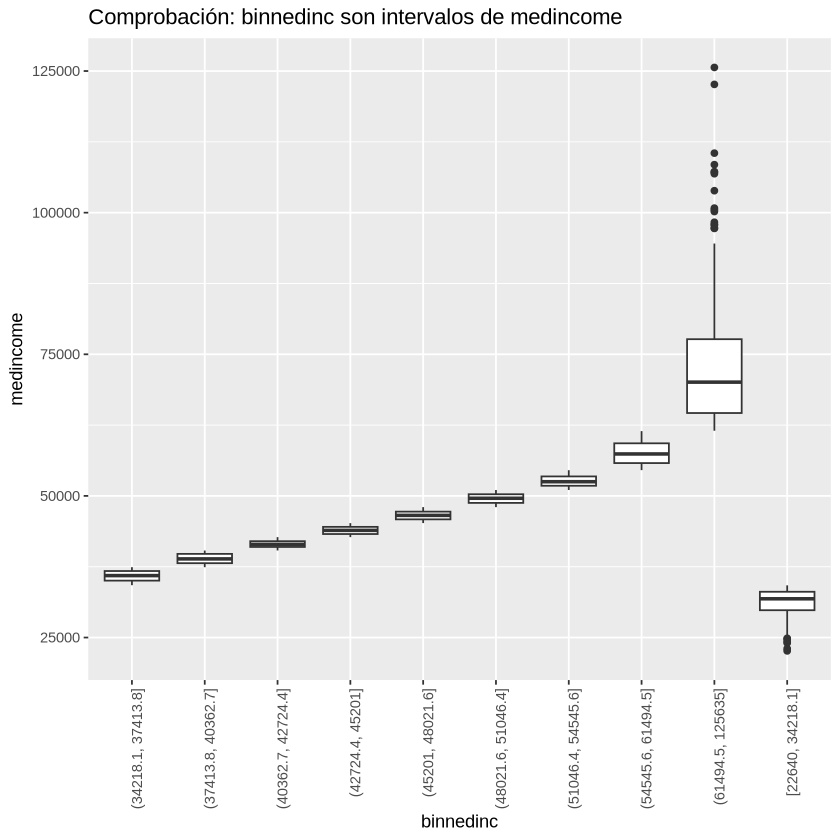

In [26]:
ggplot(data_clean, aes(x=binnedinc, y=medincome)) +
  geom_boxplot() +
  theme(axis.text.x = element_text(angle = 90, hjust = 1)) +
  labs(title="Comprobación: binnedinc son intervalos de medincome")

Se observa un patrón de escalera casi perfecta. Cada boxplot está acotada en un rango vertical específico y no se solapan entre ellas.

> El análisis gráfico confirma que `binnedinc` es una categorización de la variable continua `medincome` pero troceada y perdiendo precisión. Como hemos explicado antes en modelos de regresión, es preferible utilizar la variable continua para no perder información.

Eliminamos la variable del dataset para el modelo.

In [27]:
data_clean <- data_clean %>%
  select(-binnedinc)

### <font color='#3d59c6'> Gestión de la variable geography</font>

La variable geography contiene cadenas de texto (strings) con el nombre del condado y el estado (ej: *"Kitsap County, Washington"*).

* Los modelos de regresión lineal requieren entradas numéricas. Al ser un identificador, casi cada fila tiene un valor único. Si intentáramos convertirla a categórica (One-Hot Encoding), generaríamos 3047 nuevas columnas. Esto provocaría un overfitting.

* Primero validaremos mediante código si geography actúa realmente como un ID único (Primary Key) contando si el número de valores únicos coincide con el número total de filas. 

In [28]:
total_filas <- nrow(data_clean)
total_unicos <- length(unique(data_clean$geography))

if(total_filas == total_unicos){
  cat("Geography es un identificador único. No aporta valor predictivo numérico.\n")
}

Geography es un identificador único. No aporta valor predictivo numérico.


Al ser como hemos predicho eliminamos `geography` del dataset `data_clean` destinado al modelo.

* No es necesario crear una columna de ID artificial porqué R preserva el orden intrínseco de las filas durante las operaciones de limpieza vectorial (`dplyr`).
*  La fila $i$ del dataset limpio (`data_clean`) corresponderá posicionalmente a la fila $i$ del dataset original (`data_canc`). Si en un futuro necesitamos identificar qué condado tuvo un error de predicción alto, usaremos el índice de la fila para cruzar los datos con el archivo original.

In [29]:
data_clean <- data_clean %>%
    select(-geography)

### <font color='#3d59c6'> Análisis de Variables Estructurales y Redundancia Poblacional</font>

1. El Problema Conceptual: 
* Nuestro objetivo es predecir la target_deathrate (una tasa de riesgo relativa: muertes por cada 100k habitantes). El dataset incluye la variable avgdeathsperyear (conteo absoluto de muertes).
* Pero utilizar el número absoluto de muertes para predecir la tasa es conceptualmente erróneo. Un condado puede tener muchas muertes simplemente porque es muy grande, no porque su salud pública sea peor. Si el modelo usa esta variable, aprenderá a identificar "condados grandes" en lugar de "condados con alto riesgo de cáncer".

2. Para confirmar esta sospecha, sometremos la variable a dos pruebas de correlación:
* Prueba A: Relación con el Target
* Prueba B: Relación con la Población

In [30]:
data_clean$calculo_manual <- (data_clean$avgdeathsperyear / data_clean$popest2015) * 100000
correlacion_comprobacion <- cor(data_clean$calculo_manual, data_clean$target_deathrate)
data_clean <- data_clean %>% select(-calculo_manual)

cat("Correlación entre el cálculo manual y el target:", correlacion_comprobacion)

Correlación entre el cálculo manual y el target: 0.5620088

In [31]:
correlacion_comprobacion <- cor(data_clean$avgdeathsperyear, data_clean$popest2015)
cat("Correlación entre el promedio de muertes y la población del condado:", correlacion_comprobacion)

Correlación entre el promedio de muertes y la población del condado: 0.9776341

1. Prueba A: Relación con el Target:
    * Resultado: $R = 0.56$.
    * Aunque no es una "fuga de datos" matemática perfecta (el target es una tasa ajustada por edad y no bruta), la correlación confirma que comparten estructura, lo cual ensuciaría la interpretación de los coeficientes.

2. Prueba B: Relación con la Población:
    * Resultado: $R = 0.9776$.
    * Este hallazgo es determinante. Existe una colinealidad casi perfecta entre avgdeathsperyear y popest2015. Esto demuestra matemáticamente que el número de muertes en este dataset es un "proxy" del tamaño poblacional. El 98% de la información que aporta esta variable ya está contenida en la variable de población.

Mantener ambas variables (avgdeathsperyear y popest2015) introduciría una multicolinealidad severa que desestabilizaría el modelo.

#### Gestión de Variables Estructurales y Multicolinealidad

* Antes de finalizar el dataset final, al ver que hay variables que estan correlacionadas entre si. Decidimos realizar una auditoría conceptual de TODAS las variables (no solo las dos mencionadas en la ultima cela), para detectar posibles redundancias o fugas de datos. 

* Para resolver estos conflictos de manera sistemática y objetiva, aplicaremos un algoritmo de detección de multicolinealidad (`findCorrelation` de `caret`) con un umbral de corte de 0.90.

* Asi podremos identificar y eliminar automáticamente las variables redundantes, conservando un único "representante" estadístico por cada bloque de información. 


Variables eliminadas:
Eliminamos: [medianagemale] -> Correlaciona un 97.28% con [medianage]
Eliminamos: [medianage] -> Correlaciona un 97.28% con [medianagemale]
Eliminamos: [popest2015] -> Correlaciona un 97.76% con [avgdeathsperyear]
Eliminamos: [avgdeathsperyear] -> Correlaciona un 97.76% con [popest2015]

Dimensiones originales: 29 columnas
Dimensiones finales: 25 columnas

Superviviente del bloque EDAD
[1] "medianagefemale"        "pctprivatecoverage"     "pctempprivcoverage"    
[4] "pctpubliccoverage"      "pctpubliccoveragealone"

Superviviente del bloque TAMAÑO/POBLACIÓN
[1] "avganncount"


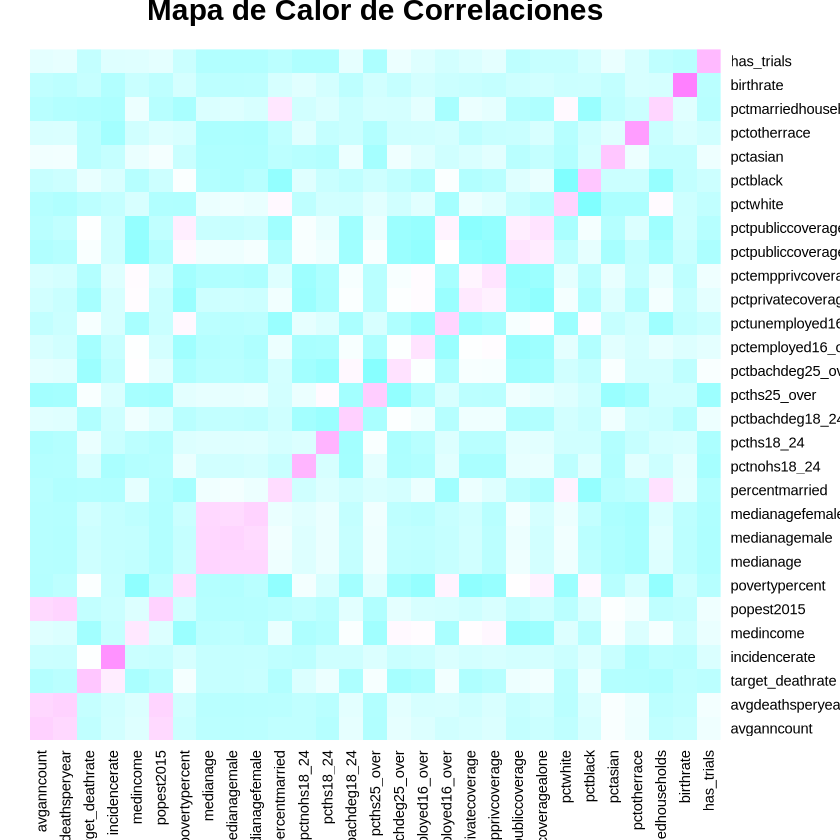

In [32]:
cor_matrix <- cor(data_clean)

heatmap(cor_matrix, Rowv=NA, Colv=NA, col = cm.colors(256), scale="column", 
        main="Mapa de Calor de Correlaciones")

high_cor_indices <- findCorrelation(cor_matrix, cutoff = 0.90)

variables_a_borrar <- names(data_clean)[high_cor_indices]

variables_a_borrar <- variables_a_borrar[variables_a_borrar != "target_deathrate"]

if(length(variables_a_borrar) > 0){
  cat("\nVariables eliminadas:\n")
  for(var in variables_a_borrar){
    corrs_var <- cor_matrix[var, ]
    corrs_var <- corrs_var[names(corrs_var) != var] 
    
    max_idx <- which.max(abs(corrs_var))
    max_name <- names(max_idx)
    max_val <- corrs_var[max_idx]
    
    cat(paste0("Eliminamos: [", var, 
               "] -> Correlaciona un ", round(max_val*100, 2), 
               "% con [", max_name, "]\n"))
  }
} else {
  cat("No se detectaron variables con correlación extrema (>90%).\n")
}

data_final <- data_clean %>%
  select(-all_of(variables_a_borrar))

cat("\nDimensiones originales:", ncol(data_clean), "columnas")
cat("\nDimensiones finales:", ncol(data_final), "columnas\n")

cat("\nSuperviviente del bloque EDAD\n")
print(names(data_final)[grepl("age", names(data_final))])

cat("\nSuperviviente del bloque TAMAÑO/POBLACIÓN\n")
vars_poblacion <- names(data_final)[grepl("pop|count|death", names(data_final))]
vars_poblacion <- vars_poblacion[vars_poblacion != "target_deathrate"]

print(vars_poblacion)

#### Interpretación de Resultados

El algoritmo ha ejecutado una reducción de dimensionalidad perfecta, ha eliminando 4 variables redundantes y resolviendo los conflictos estructurales que habiamos planteado:

1. Resolución del Bloque de Edad:
   * Eliminadas: `medianage` y `medianagemale`.
   * Superviviente: `medianagefemale`.
   * Al confirmar correlaciones superiores al 97%, el modelo ha simplificado la información demográfica conservando la edad mediana femenina como única variable representativa del envejecimiento poblacional.

 2. Resolución del Bloque de Tamaño Poblacional:
   * Eliminadas: `popest2015` y `avgdeathsperyear`.
   * Superviviente: `avganncount`.
       * Se confirma la hipótesis de redundancia estructural: `avgdeathsperyear` correlacionaba al 97.76% con `popest2015`.
       * El algoritmo ha eliminado ambas y ha conservado `avganncount` (Promedio de diagnósticos) como la variable superviviente para representar la magnitud del condado.
       * Esto elimina eficazmente el riesgo de fuga de datos, ya que la variable `avgdeathsperyear` (numerador directo del target) ha sido excluida del dataset final.

Conclusión: Ahora disponemos de un dataset final (`data_final`) de 25 columnas, libre de multicolinealidad severa y sin variables que comprometan la validez matemática del modelo.

### <font color='#3d59c6'> Analisis general final</font>

In [33]:
str(data_final)
summary(data_final)

'data.frame':	3047 obs. of  25 variables:
 $ avganncount           : num  1397 173 102 427 57 ...
 $ target_deathrate      : num  165 161 175 195 144 ...
 $ incidencerate         : num  490 412 350 430 350 ...
 $ medincome             : int  61898 48127 49348 44243 49955 52313 37782 40189 42579 60397 ...
 $ povertypercent        : num  11.2 18.6 14.6 17.1 12.5 15.6 23.2 17.8 22.3 13.1 ...
 $ medianagefemale       : num  41.7 33.7 45.8 43.4 48.9 48 43.5 52.5 49.8 37 ...
 $ percentmarried        : num  52.5 44.5 54.2 52.7 57.8 50.4 54.1 52.7 55.9 50 ...
 $ pctnohs18_24          : num  11.5 6.1 24 20.2 14.9 29.9 26.1 27.3 34.7 15.6 ...
 $ pcths18_24            : num  39.5 22.4 36.6 41.2 43 35.1 41.4 33.9 39.4 36.3 ...
 $ pctbachdeg18_24       : num  6.9 7.5 9.5 2.5 2 4.5 5.8 2.2 1.4 7.1 ...
 $ pcths25_over          : num  23.2 26 29 31.6 33.4 30.4 29.8 31.6 32.2 28.8 ...
 $ pctbachdeg25_over     : num  19.6 22.7 16 9.3 15 11.9 11.9 11.3 12 16.2 ...
 $ pctemployed16_over    : num  51.9 55.

  avganncount      target_deathrate incidencerate      medincome     
 Min.   :    6.0   Min.   : 59.7    Min.   : 201.3   Min.   : 22640  
 1st Qu.:   76.0   1st Qu.:161.2    1st Qu.: 420.3   1st Qu.: 38882  
 Median :  171.0   Median :178.1    Median : 453.5   Median : 45207  
 Mean   :  606.3   Mean   :178.7    Mean   : 448.3   Mean   : 47063  
 3rd Qu.:  518.0   3rd Qu.:195.2    3rd Qu.: 480.9   3rd Qu.: 52492  
 Max.   :38150.0   Max.   :362.8    Max.   :1206.9   Max.   :125635  
 povertypercent  medianagefemale percentmarried   pctnohs18_24     pcths18_24  
 Min.   : 3.20   Min.   :22.30   Min.   :23.10   Min.   : 0.00   Min.   : 0.0  
 1st Qu.:12.15   1st Qu.:39.10   1st Qu.:47.75   1st Qu.:12.80   1st Qu.:29.2  
 Median :15.90   Median :42.40   Median :52.40   Median :17.10   Median :34.7  
 Mean   :16.88   Mean   :42.15   Mean   :51.77   Mean   :18.22   Mean   :35.0  
 3rd Qu.:20.40   3rd Qu.:45.30   3rd Qu.:56.40   3rd Qu.:22.70   3rd Qu.:40.7  
 Max.   :47.40   Max.   :65.70

Tras ejecutar la limpieza intensiva, imputación de NAs, transformación de variables (has_trials) y filtrado por multicolinealidad, hemos obtenido un dataset final (data_final) robusto y preparado para el modelado predictivo.

Resumen del Estado del Dataset:

  * Dimensiones: 3047 observaciones y 25 variables.
  * Limpieza Estructural:
      * Se han eliminado variables redundantes de edad y tamaño de población, reduciendo el riesgo de inestabilidad en el modelo.
      * Variables como medianagefemale y popest2015 han quedado como representantes únicos de sus respectivos bloques conceptuales.
  * Calidad de Datos:
      * No existen valores perdidos (NAs).
      * La variable studypercap (altamente sesgada) ha sido sustituida por la binaria has_trials, que revela que solo el 36.6% de los condados tienen acceso a ensayos clínicos (Media: 0.3663).

Analizando el summary(data_final), destacamos:

1.  Perfil del Condado Medio:
      * Ingresos medianos de 45,207$.
      * Tasa de pobreza del 15.9%.
      * Edad mediana femenina de 42.4 años.
      * Población predominantemente blanca (90% mediana de pctwhite), aunque con gran variabilidad en otras razas.
2.  Disparidad Educativa:
      * Existe una brecha significativa en educación superior: mientras la media de licenciados (pctbachdeg25_over) es del 13.3%, el rango va desde un mínimo del 2.5% hasta un máximo del 42.2%. Dado que esta variable demostró ser el predictor más fuerte (-0.48 de correlación), esta variabilidad será clave para explicar las diferencias en mortalidad.

### <font color='#3d59c6'> Análisis descriptivo de la variable objetivo</font>

Procedemos a generar los estadísticos descriptivos y una composición visual (Histograma + Boxplot) para entender la distribución de la variable a predecir.

Estadisticos descriptivos: target_deathrate
   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
   59.7   161.2   178.1   178.7   195.2   362.8 
Desviación Típica (SD): 27.75 
Coeficiente de Asimetría: 0.27 


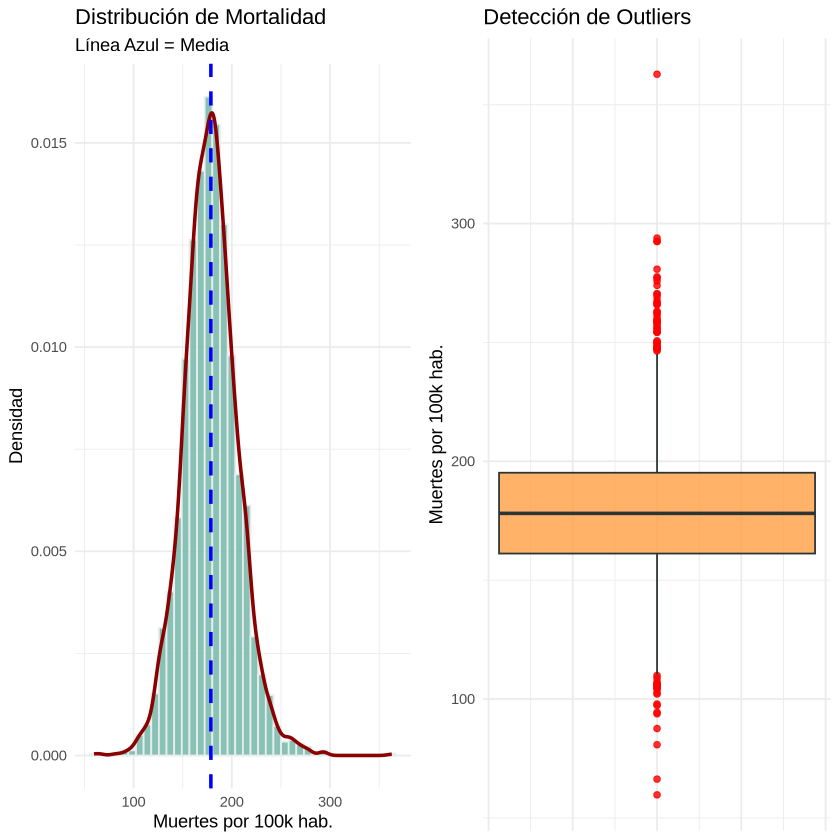

In [34]:
stats_target <- summary(data_final$target_deathrate)
sd_target <- sd(data_final$target_deathrate)
skew_target <- skewness(data_final$target_deathrate) 

cat("Estadisticos descriptivos: target_deathrate\n")
print(stats_target)
cat(paste("Desviación Típica (SD):", round(sd_target, 2), "\n"))
cat(paste("Coeficiente de Asimetría:", round(skew_target, 2), "\n"))

g_hist <- ggplot(data_final, aes(x=target_deathrate)) +
  geom_histogram(aes(y=after_stat(density)), bins=40, fill="#69b3a2", color="#e9ecef", alpha=0.8) +
  geom_density(color="darkred", lwd=1) +
  geom_vline(aes(xintercept=mean(target_deathrate)), color="blue", linetype="dashed", size=1) +
  labs(title="Distribución de Mortalidad", 
       subtitle="Línea Azul = Media",
       x="Muertes por 100k hab.", y="Densidad") +
  theme_minimal()

g_box <- ggplot(data_final, aes(y=target_deathrate)) +
  geom_boxplot(fill="#ff9f43", color="#2d3436", alpha=0.8, outlier.colour="red") +
  labs(title="Detección de Outliers", y="Muertes por 100k hab.") +
  theme_minimal() +
  theme(axis.text.x = element_blank()) 

grid.arrange(g_hist, g_box, ncol=2)

#### 1. Análisis de Normalidad (Histograma)
* Distribución Normal: El histograma muestra una clara forma de campana de Gauss. Esto es perfecto.
* Simetría: La curva de densidad (línea roja) es muy simétrica.
* Media vs Mediana: La línea azul discontinua (la media) cae justo en el centro del pico más alto. Visualmente confirma lo que vimos en los números: la Media y la Mediana son prácticamente idénticas.
* Conclusión: La variable cumple con el supuesto de Normalidad. Esto es ideal para modelos de regresión lineal, ya que no tendremos que aplicar transformaciones complejas (como logaritmos) para "arreglarla".

#### 2. Detección de Outliers (Boxplot)
* Rango Central: La caja naranja (que representa el 50% central de los datos) es bastante compacta, lo que indica que la gran mayoría de los condados de EE. UU. tienen tasas de mortalidad muy parecidas (entre 160 y 200 aprox).
* Outliers Inferiores: También hay algunos puntos abajo (mortalidad muy baja), pero son menos extremos.
* Outliers Superiores: Se observan claramente varios puntos rojos en la parte superior del Boxplot.
    * Estos son condados con tasas de mortalidad extremas (superiores a 250-300).
Ya que hay muchos outliers muy fuera de lo normal, los veremos mas a fondo:

In [35]:
top_outliers_idx <- data_final %>%
  mutate(id_fila = row_number()) %>%
  arrange(desc(target_deathrate)) %>%
  head(5) %>%
  pull(id_fila)

bottom_outliers_idx <- data_final %>%
  mutate(id_fila = row_number()) %>%
  arrange(target_deathrate) %>%
  head(5) %>%
  pull(id_fila)

cols_interes <- c("geography", "target_deathrate", "pctbachdeg25_over", "incidencerate")

cat("Outliers mayor mortalidad\n")
print(data_canc[top_outliers_idx, cols_interes])

cat("\nOutliers menor mortalidad\n")
print(data_canc[bottom_outliers_idx, cols_interes])

Outliers mayor mortalidad
                       geography target_deathrate pctbachdeg25_over
1490       Union County, Florida            362.8               5.5
1366      Woodson County, Kansas            293.9              12.7
1221 Madison County, Mississippi            292.5              26.7
2598     Powell County, Kentucky            292.5               6.1
2596      Perry County, Kentucky            280.8               7.3
     incidencerate
1490     1206.9000
1366      453.5494
1221      460.5000
2598      630.4000
2596      579.2000

Outliers menor mortalidad
                       geography target_deathrate pctbachdeg25_over
1094     Pitkin County, Colorado             59.7              42.2
1942      Presidio County, Texas             66.3              14.0
1066      Eagle County, Colorado             80.8              34.8
1403     Summit County, Colorado             87.6              32.3
464  Divide County, North Dakota             93.8              18.6
     incidencerat

Análisis de los Outliers Superiores 

1. Union County, Florida (Mortalidad: 362.8 | Incidencia: 1206.9)
* Este es un outlier "artificial" y muy conocido en estadística de salud pública. Union County alberga la Union Correctional Institution (una prisión de máxima seguridad) y el centro médico de recepción de prisioneros (RMC) del estado.
* El censo cuenta a los presos como residentes. Muchos presos llegan allí ancianos o enfermos terminales para ser tratados en el hospital penitenciario, y mueren allí.
* La incidencia y mortalidad están disparadas artificialmente por la concentración de enfermos en la cárcel, no porque el condado en sí sea tóxico.

2. Woodson County, Kansas
* Al observar los datos reales, vemos que este condado tiene una mortalidad altísima a pesar de tener una incidencia de cáncer normal. Esto se explica por la realidad demográfica de la zona, no por un error de cálculo.
* Es una zona con una mediana de edad muy superior a la media nacional. Dado que el cáncer es más letal en edades avanzadas, la tasa de mortalidad real se dispara naturalmente.
* Es un condado con muy pocos habitantes (~3,000). En estadística descriptiva, las tasas calculadas sobre poblaciones tan pequeñas suelen ser muy volátiles (un pequeño número de muertes naturales provoca un pico enorme en la tasa).

3. Powell & Perry County, Kentucky
* Estos condados están en el corazón de los Apalaches, una región históricamente minera (carbón).
* Esta zona tiene consistentemente las tasas de tabaquismo, obesidad y pobreza más altas de EE. UU. Además, hay factores ambientales derivados de la minería.
* Aquí la Educación baja (6-7%) capturó perfectamente la realidad. La baja educación es un proxy de este estilo de vida de alto riesgo y exposición ambiental. 

4. Madison County, Mississippi
* Es un condado rico con alta educación (26.7%), pero alta mortalidad.
* Mississippi tiene las mayores disparidades raciales en salud de EE. UU. Aunque el promedio de ingresos es alto, existen bolsas de pobreza extrema y falta de acceso a prevención para la población afroamericana en ciertas zonas rurales del condado.

---

Análisis de los Outliers Inferiores 

1. El Cluster de Colorado: Pitkin, Eagle & Summit County
* Estos no son condados normales. Son Aspen, Vail y Breckenridge. Son las zonas de estaciones de esquí de lujo.
* Explicación:
    * Tienen la mayor concentración de millonarios.
    * Tienen las tasas de obesidad más bajas de todo Estados Unidos y las tasas de actividad física más altas.
    * Atraen a gente joven y sana para trabajar en turismo, y gente rica y sana para retirarse.

2. Presidio County, Texas
* Es un condado en la frontera con México.
* Esto se conoce como la "Paradoja Hispana". Estadísticamente, en el suroeste de EE. UU., las poblaciones de inmigrantes latinos de primera generación suelen tener menores tasas de mortalidad por cáncer que los blancos no hispanos, a pesar de tener menos ingresos, debido a dietas diferentes y redes de apoyo familiar más fuertes.

Decidimos no eliminar ningún dato de estos.

Aunque son casos extremos en los datos reales:
1.  Representan situaciones que existen en EE. UU. (zonas muy envejecidas, zonas rurales, zonas con instituciones especiales).
2.  Si los eliminamos ahora, antes de modelar, perderemos la capacidad de ver si nuestro futuro modelo es capaz de detectar estas anomalías.

En conclusión de esta parte mantenemos todos los registros en el dataset `data_final`.

### <font color='#3d59c6'> Análisis descriptivo de las variables explicativas</font>

Procedemos a generar los estadísticos descriptivos y una composición visual (Histograma + Boxplot) para entender la distribución de las variables explicativas.

In [36]:
vars_explicativas <- data_final %>% 
  select(-target_deathrate, -has_trials)

metricas <- data.frame(
  Variable = names(vars_explicativas),
  Media = sapply(vars_explicativas, mean),
  Mediana = sapply(vars_explicativas, median),
  SD = sapply(vars_explicativas, sd),
  Min = sapply(vars_explicativas, min),
  Max = sapply(vars_explicativas, max)
)

print("Resumen:")
print(head(metricas, 10))

[1] "Resumen:"
                       Variable        Media    Mediana           SD     Min
avganncount         avganncount   606.338544   171.0000  1416.356223     6.0
incidencerate     incidencerate   448.268586   453.5494    54.560733   201.3
medincome             medincome 47063.281917 45207.0000 12040.090836 22640.0
povertypercent   povertypercent    16.878175    15.9000     6.409087     3.2
medianagefemale medianagefemale    42.145323    42.4000     5.292849    22.3
percentmarried   percentmarried    51.773679    52.4000     6.896928    23.1
pctnohs18_24       pctnohs18_24    18.224450    17.1000     8.093064     0.0
pcths18_24           pcths18_24    35.002068    34.7000     9.069722     0.0
pctbachdeg18_24 pctbachdeg18_24     6.158287     5.4000     4.529059     0.0
pcths25_over       pcths25_over    34.804660    35.3000     7.034924     7.5
                     Max
avganncount      38150.0
incidencerate     1206.9
medincome       125635.0
povertypercent      47.4
medianagefema

`avganncount`
* Media (606) vs Mediana (171). Desviación Típica (1416). Máximo (38,150).
* Existe una asimetría positiva brutal. La media es casi 4 veces mayor que la mediana.
* Esto confirma que hay unos pocos condados con una cantidad masiva de diagnósticos (grandes ciudades) que arrastran el promedio hacia arriba. Esta variable tiene una varianza extrema y confirma por qué las variables de "conteo" son peligrosas frente a las de "tasa".

`incidencerate`
* Media (448.2) vs Mediana (453.5).
* Son casi idénticas. La desviación típica es baja (54) comparada con la media.
* La tasa de aparición de cáncer es muy estable en todo el país. Sigue una distribución Normal casi perfecta. 

`medincome` y `povertypercent`
* El rango va desde 22,640 (muy pobre) hasta 125,635 (muy rico).
* El máximo es 47.4%.
* Hay una disparidad enorme. En el peor condado, casi la mitad de la población vive en la pobreza.
* Esta alta variabilidad (SD alta) es muy buena para el modelo. Necesitamos que haya condados ricos y pobres bien diferenciados para que la regresión pueda aprender cómo afecta el dinero a la mortalidad. Si todos fueran iguales, el modelo no aprendería nada.

`pctbachdeg18_24`
* Mínimo 0.0%.
* Hay condados donde literalmente nadie (o casi nadie) entre 18 y 24 años tiene un título universitario, mientras que en otros es el 51.8%.
* Esto refleja la fuga de cerebros o zonas rurales muy deprimidas vs ciudades universitarias. Es un indicador potente de desarrollo local.

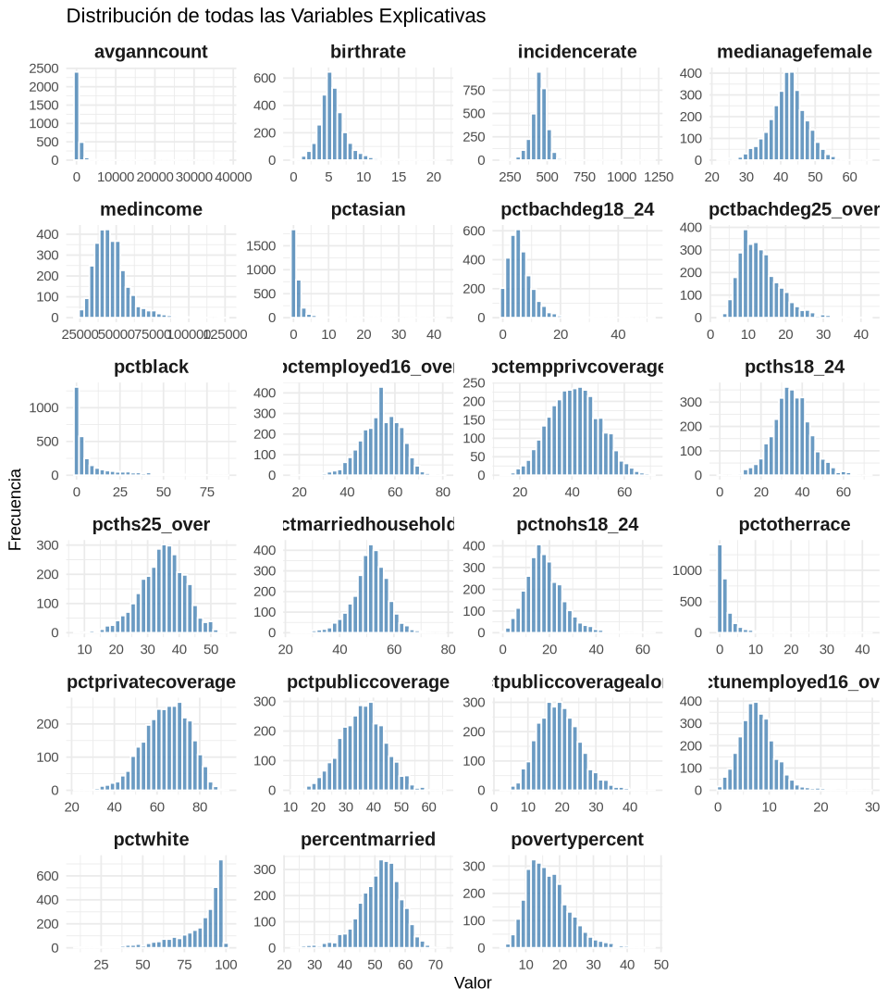

In [37]:
prev_width <- getOption("repr.plot.width")
prev_height <- getOption("repr.plot.height")

options(repr.plot.width=8, repr.plot.height=9) 

datos_largos <- vars_explicativas %>%
  pivot_longer(cols = everything(), names_to = "Variable", values_to = "Valor")

p <- ggplot(datos_largos, aes(x = Valor)) +
  geom_histogram(bins = 30, fill = "steelblue", color = "white", alpha = 0.8) +
  facet_wrap(~ Variable, scales = "free", ncol = 4) + 
  labs(title = "Distribución de todas las Variables Explicativas",
       x = "Valor",
       y = "Frecuencia") +
  theme_minimal() +
  theme(
    strip.text = element_text(face = "bold", size = 12),
    axis.text = element_text(size = 9)
  )

print(p)

options(repr.plot.width = ifelse(is.null(prev_width), 8, prev_width),
        repr.plot.height = ifelse(is.null(prev_height), 6, prev_height))

1. Variables con Distribución Normal (Campana de Gauss):
La mayoría de las variables socioeconómicas y demográficas estándar presentan una distribución muy limpia, centrada y simétrica. Esto indica estabilidad y datos bien comportados.
* Ejemplos Claros: `pctemployed16_over`, `percentmarried`, `pcths25_over` (educación secundaria), `medianagefemale`.
* La mayoría de condados de EE. UU. se agrupan en torno a una media nacional estándar en empleo, edad y nivel educativo básico.

2. Variables con Sesgo Marcado a la Derecha (Cola Larga):
Este es el grupo más interesante porque revela desigualdades y minorías. Tienen una barra alta a la izquierda (muchos ceros o valores bajos) y una cola que se extiende hacia la derecha.
* Variables Raciales: `pctblack`, `pctasian`, `pctotherrace`.
    * La inmensa mayoría de condados son homogéneos (probablemente mayoría blanca, viendo `pctwhite`), pero hay unos pocos condados con altas concentraciones de población negra o asiática.
* Población (`popest2015`): Se ve casi como una sola línea a la izquierda.
    * EE. UU. tiene miles de condados rurales minúsculos y unas pocas megaciudades (Nueva York, LA) que no se ven en el gráfico por la escala, pero que "aplastan" el histograma.
* Ingresos (`medincome`): También muestra sesgo positivo. Hay un tope inferior (nadie gana 0), pero no hay tope superior, lo que alarga la cola hacia los condados ricos.

3. Variables con Comportamiento Irregular:
* `pctbachdeg25_over` (Licenciados): Aunque parece normal, tiene una cola derecha más pronunciada que la educación secundaria (`pcths25_over`). Esto confirma que la educación superior es un factor de diferenciación (elitismo) entre condados, mientras que la secundaria es universal.
* `povertypercent`: Tiene un sesgo hacia la derecha (similar a ingresos pero invertido). La mayoría de condados tienen pobreza baja/media, pero la cola derecha muestra bolsas de pobreza extrema preocupantes.

4. La Disparidad en Cobertura Sanitaria (`pctprivatecoverage` vs `pctpubliccoverage`)
* Si comparamos los histogramas de `pctprivatecoverage` y `pctpubliccoverage`, vemos un patrón inverso muy interesante.
    * Cobertura Privada: Tiende a una distribución normal pero ligeramente sesgada a la derecha (hay una masa sólida de gente con seguro privado, y luego condados muy ricos donde casi todos lo tienen).
    * Cobertura Pública: Es más "chata" y con una cola hacia la derecha (condados donde mucha gente depende del estado).
* Esto sugiere que el sistema de salud no es uniforme. Hay una correlación visual negativa: los condados que "faltan" en la cobertura privada probablemente son los que "llenan" la pública, reflejando la segmentación económica del acceso a la salud.

5. La "Normalidad Rara" de `medianagefemale` vs otras demográficas:
* Si nos fijamos en `medianagefemale`. Es una campana de Gauss casi perfecta.
* Esto indica que el envejecimiento poblacional es extremadamente homogéneo en EE. UU. A diferencia de la raza o los ingresos (que tienen colas largas y desigualdades brutales), la edad media es casi la misma en todas partes (alrededor de 40-42 años).
* Esto significa que la edad, aunque importante, probablemente no será el factor que mejor discrimine entre condados ricos y pobres o sanos y enfermos, porque varía muy poco entre unos y otros.

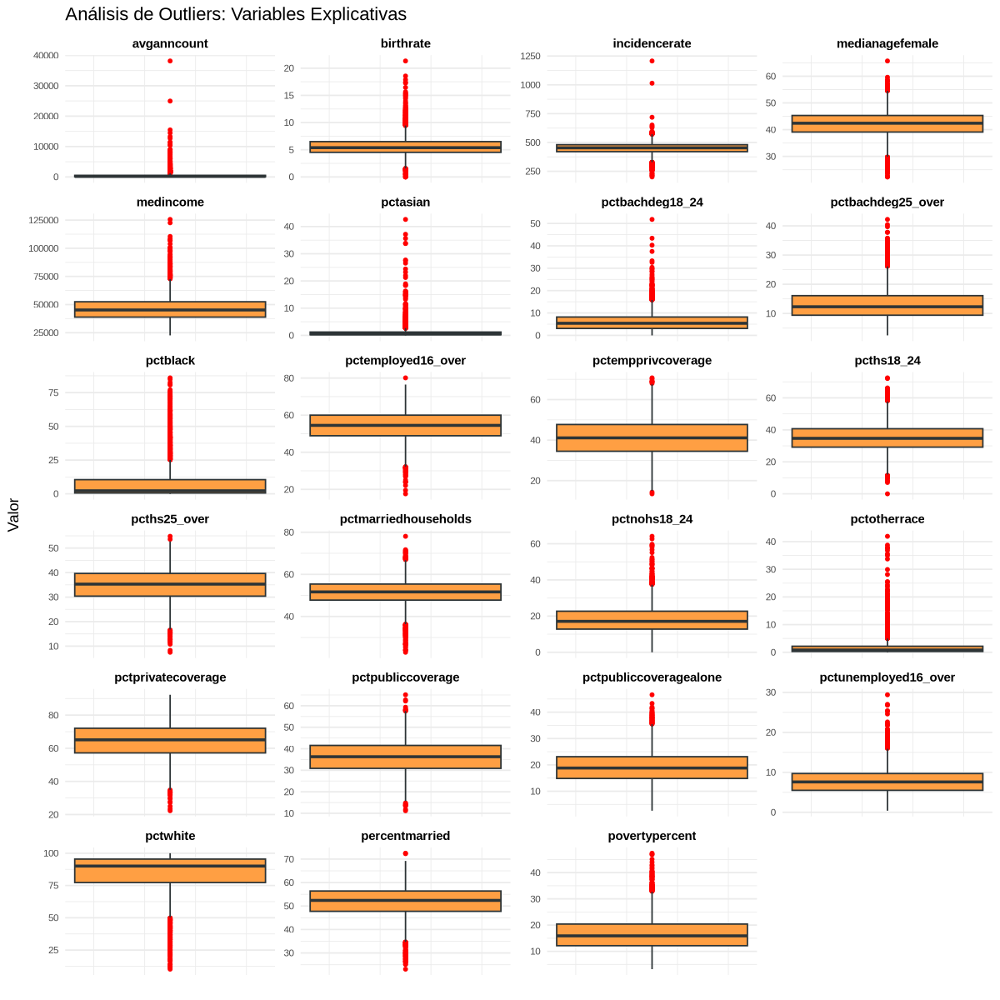

In [38]:
prev_width <- getOption("repr.plot.width")
prev_height <- getOption("repr.plot.height")

options(repr.plot.width=10, repr.plot.height=10) 

datos_largos <- data_final %>%
  select(-target_deathrate, -has_trials) %>%
  pivot_longer(cols = everything(), names_to = "Variable", values_to = "Valor")

ggplot(datos_largos, aes(y = Valor)) +
  geom_boxplot(fill = "#ff9f43", color = "#2d3436", outlier.colour = "red", outlier.size = 1) +
  
  facet_wrap(~ Variable, scales = "free", ncol = 4) +
  
  labs(title = "Análisis de Outliers: Variables Explicativas",
       y = "Valor", x = "") +
  
  theme_minimal() +
  theme(
    strip.text = element_text(face = "bold", size = 9, color = "black"),
    axis.text.y = element_text(size = 7), 
    axis.text.x = element_blank(), 
    panel.grid.major.x = element_blank() 
  )

options(repr.plot.width = ifelse(is.null(prev_width), 8, prev_width),
        repr.plot.height = ifelse(is.null(prev_height), 6, prev_height))

1.  Las variables de conteo poblacional como `avganncount` y `popest2015` muestran una distribución exponencial clara:
    * El cuerpo principal de los datos aparece comprimido cerca del cero, mientras que una serie de valores atípicos se extiende hacia el extremo superior.
    * Esto refleja la realidad demográfica, donde la mayoría de los condados son pequeños y unas pocas áreas metropolitanas grandes distorsionan la escala visual.

2.  Variables socioeconómicas y clínicas como `medincome` e `incidencerate` presentan cajas bien definidas pero con una notable cantidad de valores atípicos en la parte superior.
    * En el caso de los ingresos, esto indica la existencia de condados con niveles de riqueza muy superiores a la media nacional.
    * Para la tasa de incidencia, señala zonas críticas con una prevalencia de cáncer anormalmente alta que podrían requerir atención epidemiológica específica.

3.  Un grupo de variables demográficas, incluyendo `percentmarried`, `pctemployed16_over` y `medianagefemale`, exhibe un comportamiento muy estable y simétrico.
    * Las cajas son amplias y centradas, con pocos valores extremos, lo que sugiere una homogeneidad estructural en estas características a lo largo del país.
    * Estas variables actuarán como predictores robustos y seguros en el modelo.

4.  Las variables relacionadas con minorías raciales (`pctblack`, `pctasian`) muestran distribuciones altamente sesgadas hacia la derecha:
    * La mediana se sitúa en valores muy bajos, indicando que la gran mayoría de los condados de EE. UU. tienen poca diversidad racial.
    * Las colas largas hacia arriba identifican condados específicos donde estas poblaciones son mayoritarias, actuando como outliers demográficos significativos.

5.  Existe una disparidad estructural en la educación según la edad (`pctbachdeg18_24` vs `pctbachdeg25_over`):
    * La educación joven muestra una mediana mucho más baja y comprimida que la adulta.
    * Esto sugiere un patrón de migración o concentración del talento joven cualificado en pocos "hubs" (outliers), dejando a gran parte de los condados rurales con niveles mínimos de población joven universitaria.

### <font color='#3d59c6'> Escoged las 2 variables que a priori se observe que mejor ajustarían en un modelo de regresión lineal y justificad el porqué </font>

Utilizaremos el criterio matemático estándar para la selección de variables en regresión lineal simple: el Coeficiente de Correlación de Pearson ($r$). Al ordenar por el valor absoluto (Abs_Correlacion), identificaremos qué variables tienen la relación lineal más fuerte con el objetivo, independientemente de si esa relación es positiva (aumenta la mortalidad) o negativa (disminuye la mortalidad).

[1] "Top 10 mejores variables predictoras:"
                 Variable Correlacion Abs_Correlacion
1       pctbachdeg25_over  -0.4854773       0.4854773
2           incidencerate   0.4494317       0.4494317
3  pctpubliccoveragealone   0.4493576       0.4493576
4          povertypercent   0.4293890       0.4293890
5               medincome  -0.4286149       0.4286149
6            pcths25_over   0.4045891       0.4045891
7       pctpubliccoverage   0.4045717       0.4045717
8      pctemployed16_over  -0.3974325       0.3974325
9      pctprivatecoverage  -0.3860655       0.3860655
10   pctunemployed16_over   0.3784124       0.3784124


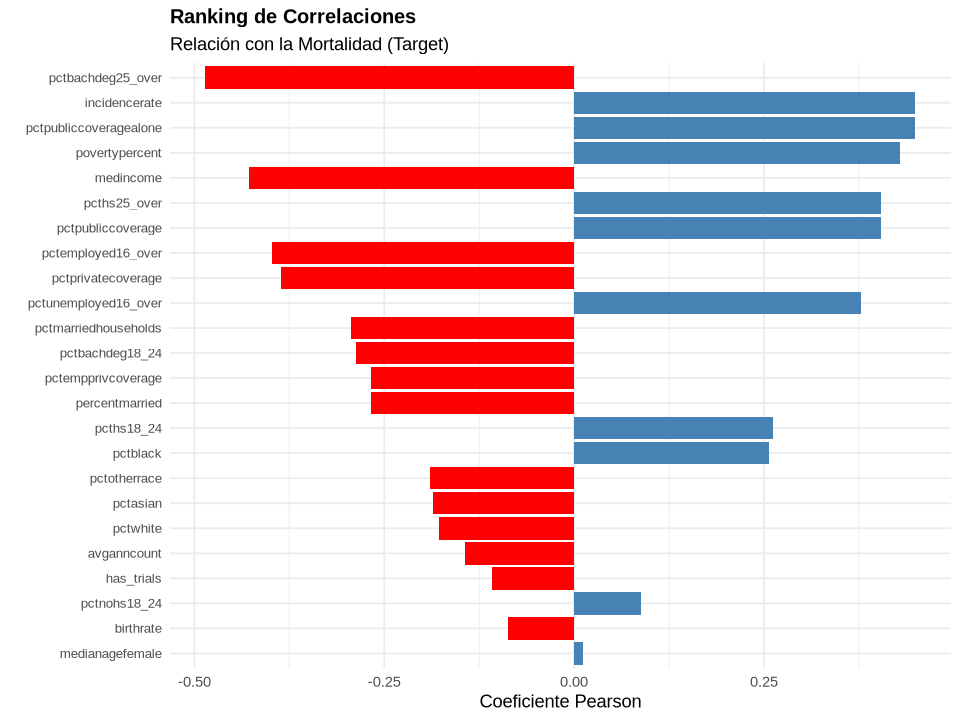

In [39]:
options(repr.plot.width=8, repr.plot.height=6)

cor_matrix <- cor(data_final %>% select_if(is.numeric))

ranking <- as.data.frame(cor_matrix) %>% 
  select(target_deathrate) %>%             
  rownames_to_column(var = "Variable") %>% 
  filter(Variable != "target_deathrate") %>% 
  rename(Correlacion = target_deathrate) %>%
  mutate(Abs_Correlacion = abs(Correlacion)) %>% 
  arrange(desc(Abs_Correlacion)) 

print("Top 10 mejores variables predictoras:")
print(head(ranking, 10)) 

ggplot(ranking, aes(x = reorder(Variable, Abs_Correlacion), y = Correlacion)) +
  geom_col(aes(fill = Correlacion > 0), show.legend = FALSE) + 
  coord_flip() + 
  labs(title = "Ranking de Correlaciones",
       subtitle = "Relación con la Mortalidad (Target)",
       x = "", 
       y = "Coeficiente Pearson") +
  scale_fill_manual(values = c("red", "steelblue")) +
  theme_minimal() +
  theme(
    axis.text.y = element_text(size = 8), 
    plot.title = element_text(size = 12, face = "bold")
  )

Basándonos en el ranking de correlación generado, las dos variables seleccionadas son:

1. `pctbachdeg25_over` (Factor Socioeconómico / Educación Superior) (Porcentaje de Licenciados \> 25 años)
  * Es la variable con el mayor coeficiente de correlación absoluto del dataset ($r = -0.485$). Esto indica que es el predictor individual más potente para explicar la varianza de la tasa de mortalidad.
  * La correlación negativa indica que a mayor nivel educativo, menor mortalidad. Esta variable actúa como un excelente proxy del nivel socioeconómico general, acceso a seguros médicos privados, mejor estilo de vida y mayor adherencia a la prevención y tratamientos médicos.

2. `incidencerate` (Factor Clínico / Incidencia) (Tasa media de diagnósticos por año)
  * Es la segunda variable más fuerte en el ranking global ($r = 0.449$) y la variable más fuerte con correlación positiva.
  * Representa la causa biológica directa. Es lógico que, si en un condado enferma más gente de cáncer (mayor incidencia), la tasa de mortalidad tienda a subir. Seleccionar esta variable nos permite contrastar el impacto de la "biología" (incidencia) frente al impacto del "entorno social" (educación).

*(Nota: Aunque `pctpubliccoveragealone` tiene una correlación casi idéntica a la incidencia ($0.4493$ vs $0.4494$), preferimos `incidencerate` por ser una medida clínica directa, mientras que la cobertura pública suele estar muy correlacionada con la pobreza, información que ya capturamos parcialmente con la educación).*

### <font color='#3d59c6'> Análisis bivariante entre la variable objetivo vs las variables explicativas </font>

Ahora procederemos a comparar las variables elegidas con la variable objectivo mediante graficos:

`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'


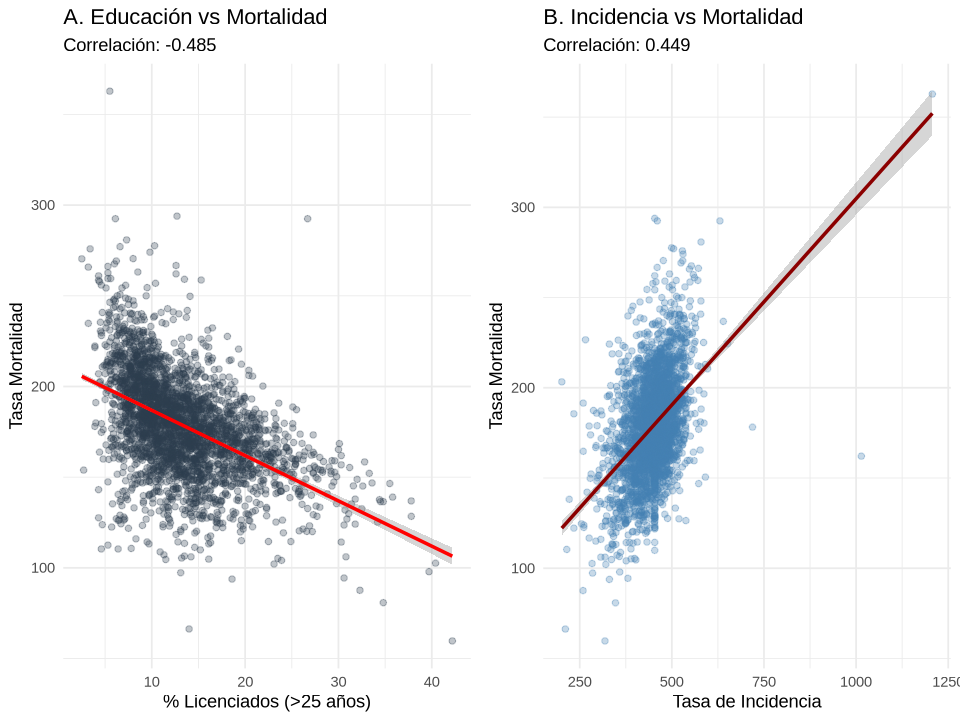

In [40]:
p1 <- ggplot(data_final, aes(x = pctbachdeg25_over, y = target_deathrate)) +
  geom_point(alpha = 0.3, color = "#2c3e50") +
  geom_smooth(method = "lm", color = "red", se = TRUE) +
  labs(title = "A. Educación vs Mortalidad", 
       subtitle = paste("Correlación: -0.485"),
       x = "% Licenciados (>25 años)", y = "Tasa Mortalidad") +
  theme_minimal()

p2 <- ggplot(data_final, aes(x = incidencerate, y = target_deathrate)) +
  geom_point(alpha = 0.3, color = "steelblue") +
  geom_smooth(method = "lm", color = "darkred", se = TRUE) +
  labs(title = "B. Incidencia vs Mortalidad", 
       subtitle = paste("Correlación: 0.449"),
       x = "Tasa de Incidencia", y = "Tasa Mortalidad") +
  theme_minimal()

grid.arrange(p1, p2, ncol = 2)

#### Análisis e Interpretación

1.  Variable Socioeconómica (pctbachdeg25\_over) - Gráfico A
  * Se observa una clara pendiente negativa. A medida que nos movemos hacia la derecha (mayor porcentaje de población con estudios superiores), la nube de puntos desciende (menor mortalidad).
  * La dispersión de los puntos alrededor de la línea roja es relativamente homogénea, lo que confirma que un modelo lineal simple capturará bien esta tendencia.
  * La educación actúa como un factor protector. Condados con mayor nivel educativo (probablemente correlacionado con mayores ingresos y mejor acceso a salud) tienen sistemáticamente menos muertes por cáncer.

2.  Variable Clínica (incidencerate) - Gráfico B
  * Muestra una pendiente positiva. A mayor número de diagnósticos de cáncer (eje X), mayor es la tasa de mortalidad (eje Y).
  * La relación es lineal, aunque se observa una dispersión considerable y algunos outliers en valores altos de incidencia (\>1000) que se alejan de la línea de tendencia.
  * Valida la relación biológica directa: la incidencia es un factor de riesgo proporcional a la mortalidad.

Ambas variables presentan relaciones lineales claras que justifican su uso individual para generar modelos de regresión lineal simple (lm), siendo la variable educativa la que presenta una dispersión ligeramente menor (mejor ajuste). 

Para verlo mejor haremos los mismos graficos pero con un mapa de calor.

`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'


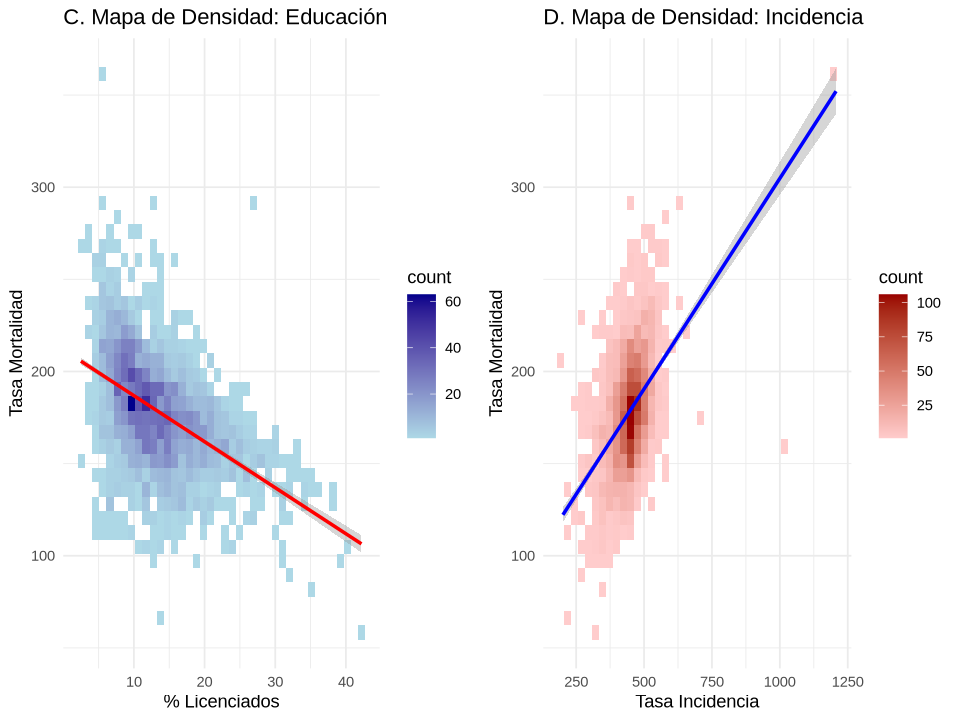

In [41]:
g_dens_edu <- ggplot(data_final, aes(x = pctbachdeg25_over, y = target_deathrate)) +
  stat_bin2d(bins = 40) + 
  scale_fill_gradient(low = "lightblue", high = "darkblue") +
  geom_smooth(method = "lm", color = "red", lwd = 1) + 
  labs(title = "C. Mapa de Densidad: Educación",
       x = "% Licenciados", y = "Tasa Mortalidad") +
  theme_minimal()

g_dens_inc <- ggplot(data_final, aes(x = incidencerate, y = target_deathrate)) +
  stat_bin2d(bins = 40) +
  scale_fill_gradient(low = "#ffcccc", high = "#990000") +
  geom_smooth(method = "lm", color = "blue", lwd = 1) +
  labs(title = "D. Mapa de Densidad: Incidencia",
       x = "Tasa Incidencia", y = "Tasa Mortalidad") +
  theme_minimal()

grid.arrange(g_dens_edu, g_dens_inc, ncol = 2)

3. Gráfico C: Educación (`pctbachdeg25_over`) vs Mortalidad:
* Se observa una gran concentración de condados en la zona azul oscuro.
* Esta mancha oscura sigue una diagonal descendente. Esto valida visualmente que, para la gran mayoría de los condados de EE. UU., a medida que aumenta el nivel educativo (hacia la derecha), la mortalidad disminuye (hacia abajo).
* Confirma el efecto protector de la educación de forma robusta.

4. Gráfico D: Incidencia (`incidencerate`) vs Mortalidad:
* La concentración principal (rojo oscuro) está en el centro-izquierda.
* La mancha y la línea de tendencia muestran una diagonal ascendente.
* Confirma que a mayor tasa de diagnósticos (incidencia), mayor mortalidad. Sin embargo, la dispersión vertical de la mancha es un poco mayor que en el gráfico de educación, lo que sugiere que la educación podría ser un predictor ligeramente más preciso (menos ruido) que la incidencia para el grueso de los datos.

En resumen, ambos gráficos validan que las relaciones lineales no son producto de unos pocos valores extremos, sino del comportamiento del grueso de la población (las zonas oscuras).

#### Profundización mediante Segmentación (Boxplots)

Aunque el mapa de calor confirma las correlaciones lineales generales, necesitamos entender cómo cambia el riesgo de mortalidad en los extremos de la distribución. Para ello, segmentaremos los condados en cuartiles (Bajo, Medio, Alto) según su nivel educativo y de incidencia. Esto nos permitirá visualizar no solo la tendencia central, sino también la estabilidad y varianza del riesgo dentro de cada grupo.

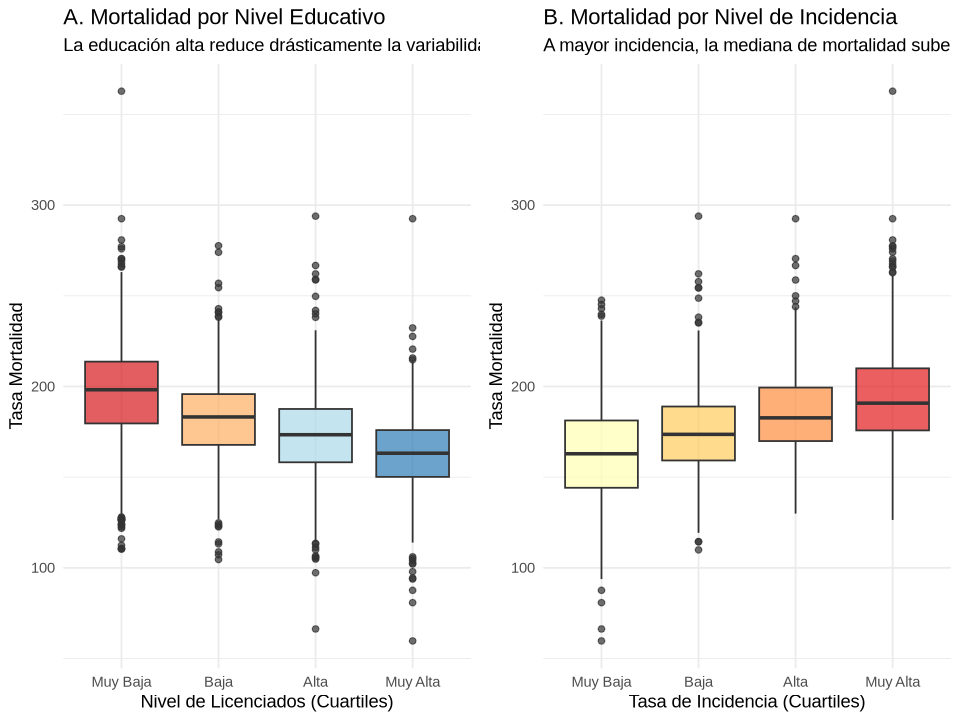

In [42]:
data_final$Grupo_Edu <- cut(data_final$pctbachdeg25_over, 
                            breaks = quantile(data_final$pctbachdeg25_over, probs = 0:4/4),
                            labels = c("Muy Baja", "Baja", "Alta", "Muy Alta"),
                            include.lowest = TRUE)

data_final$Grupo_Inc <- cut(data_final$incidencerate, 
                            breaks = quantile(data_final$incidencerate, probs = 0:4/4),
                            labels = c("Muy Baja", "Baja", "Alta", "Muy Alta"),
                            include.lowest = TRUE)

g_box_edu <- ggplot(data_final, aes(x = Grupo_Edu, y = target_deathrate, fill = Grupo_Edu)) +
  geom_boxplot(alpha = 0.7, show.legend = FALSE) +
  scale_fill_brewer(palette = "RdYlBu") + 
  labs(title = "A. Mortalidad por Nivel Educativo",
       subtitle = "La educación alta reduce drásticamente la variabilidad",
       x = "Nivel de Licenciados (Cuartiles)", y = "Tasa Mortalidad") +
  theme_minimal()

g_box_inc <- ggplot(data_final, aes(x = Grupo_Inc, y = target_deathrate, fill = Grupo_Inc)) +
  geom_boxplot(alpha = 0.7, show.legend = FALSE) +
  scale_fill_brewer(palette = "YlOrRd") + 
  labs(title = "B. Mortalidad por Nivel de Incidencia",
       subtitle = "A mayor incidencia, la mediana de mortalidad sube",
       x = "Tasa de Incidencia (Cuartiles)", y = "Tasa Mortalidad") +
  theme_minimal()

grid.arrange(g_box_edu, g_box_inc, ncol = 2)

#### Análisis de Resultados 

1. Gráfico A: Mortalidad por Nivel Educativo (pctbachdeg25_over)
* Patrón de Escalera: Se observa una clara progresión descendente. Las cajas se sitúan escalonadamente más abajo a medida que nos movemos de izquierda a derecha. El grupo de educación "Muy Baja" presenta la mediana de mortalidad más alta, mientras que el grupo "Muy Alta" tiene la más baja.
* Reducción de Riesgo y Varianza: Es notable que la caja azul (educación muy alta) es significativamente más pequeña y compacta que la roja. Esto indica que los condados con mayor nivel educativo no solo tienen menos mortalidad en promedio, sino que son mucho más predecibles y estables, con menor riesgo de sufrir crisis de mortalidad extremas.

2. Gráfico B: Mortalidad por Nivel de Incidencia (incidencerate)
* Patrón Ascendente: La tendencia es inversa a la anterior. La escalera sube de izquierda a derecha, confirmando que los grupos con mayor incidencia de cáncer sufren mayor mortalidad.
* Solapamiento y Discriminación: A diferencia del gráfico de educación, aquí las cajas presentan un mayor solapamiento entre niveles adyacentes. Esto sugiere que, aunque la incidencia es un factor de riesgo directo, no discrimina los grupos de riesgo con tanta nitidez y limpieza como lo hace el nivel socioeconómico.

3. Conclusión Comparativa
* Los diagramas confirman la robustez de ambas variables. Sin embargo, la segmentación revela que la educación actúa como un discriminador más potente, ya que logra separar mejor los grupos de bajo y alto riesgo (menos solapamiento) y reduce drásticamente la variabilidad en los niveles superiores.

## <font color='#3d59c6'> 2. Desarrollo del mejor modelo </font>

#### Generad un modelo de regresión lineal simple para cada una de las variables escogidas

Para construir y evaluar modelos predictivos fiables, no basta con ajustar una línea a todos los datos disponibles. Es necesario seguir una metodología que garantice la capacidad de generalización del modelo. A continuación, procedemos con el siguiente flujo de trabajo:

1. Partición de Datos (Train/Test Split):
Antes de entrenar nada, dividimos el dataset limpio (`data_final`) en dos subconjuntos exclusivos utilizando una proporción 80/20:

  * Conjunto de Entrenamiento (Train - 80%): Se utilizará para que el modelo aprenda la relación matemática (calcule la pendiente y la intersección).
  * Conjunto de Prueba (Test - 20%): Se mantiene oculto durante el entrenamiento y se usará exclusivamente al final para validar si el modelo funciona con datos nuevos.
  * *Nota:* Fijamos una semilla (`set.seed(123)`) para garantizar que esta división sea aleatoria pero reproducible.

2. Entrenamiento de Modelos Rivales:
Generamos dos modelos de regresión lineal simple (`lm`) independientes utilizando el conjunto de entrenamiento:
  * Modelo A (Socioeconómico): Intenta predecir la mortalidad basándose únicamente en el nivel educativo (`pctbachdeg25_over`).
  * Modelo B (Clínico): Intenta predecir la mortalidad basándose únicamente en la tasa de incidencia (`incidencerate`).

3. Criterio de Selección:
* Una vez entrenados, extraemos el Coeficiente de Determinación ($R^2$) de cada modelo. Este indicador nos dice qué porcentaje de la variabilidad de la mortalidad es capaz de explicar cada variable.

El código comparará automáticamente ambos valores y seleccionará como Ganador aquel modelo que tenga el mayor $R^2$, ya que esto implica una mayor capacidad explicativa sobre los datos de entrenamiento.

In [45]:
set.seed(123) 

trainIndex <- createDataPartition(data_final$target_deathrate, p = 0.8, list = FALSE)

data_train <- data_final[trainIndex, ]
data_test  <- data_final[-trainIndex, ]

cat("Filas para Entrenar (Train):", nrow(data_train), "\n")
cat("Filas para Validar (Test): ", nrow(data_test), "\n\n")

modelo_edu <- lm(target_deathrate ~ pctbachdeg25_over, data = data_train)
modelo_inc <- lm(target_deathrate ~ incidencerate, data = data_train)

cat(" Modelo A: Educación (pctbachdeg25_over)\n")
print(summary(modelo_edu))

cat("---------------------------------------\n\n")
cat(" Modelo B: Incidencia (incidencerate)\n")
print(summary(modelo_inc))

r2_edu <- summary(modelo_edu)$r.squared
r2_inc <- summary(modelo_inc)$r.squared

cat("\nVeredicto TRAIN\n")
cat(paste("Capacidad Explicativa (R2) Educación:", round(r2_edu, 4), "\n"))
cat(paste("Capacidad Explicativa (R2) Incidencia:", round(r2_inc, 4), "\n"))

if(r2_edu > r2_inc){
  diff <- round((r2_edu - r2_inc) * 100, 2)
  cat(paste("El modelo de EDUCACIÓN es mejor (explica un", diff, "% más de varianza)."))
} else {
  diff <- round((r2_inc - r2_edu) * 100, 2)
  cat(paste("El modelo de INCIDENCIA es mejor (explica un", diff, "% más de varianza)."))
}

Filas para Entrenar (Train): 2439 
Filas para Validar (Test):  608 

 Modelo A: Educación (pctbachdeg25_over)

Call:
lm(formula = target_deathrate ~ pctbachdeg25_over, data = data_train)

Residuals:
     Min       1Q   Median       3Q      Max 
-110.511  -14.796    1.021   14.576  164.811 

Coefficients:
                   Estimate Std. Error t value Pr(>|t|)    
(Intercept)       211.69188    1.30016  162.82   <2e-16 ***
pctbachdeg25_over  -2.49149    0.09095  -27.39   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 24.15 on 2437 degrees of freedom
Multiple R-squared:  0.2354,	Adjusted R-squared:  0.2351 
F-statistic: 750.5 on 1 and 2437 DF,  p-value: < 2.2e-16

---------------------------------------

 Modelo B: Incidencia (incidencerate)

Call:
lm(formula = target_deathrate ~ incidencerate, data = data_train)

Residuals:
     Min       1Q   Median       3Q      Max 
-144.934  -16.803   -1.567   15.698  111.042 

Coefficients:
 

#### 1. Análisis Modelo A (Educación) - Modelo Seleccionado

Este modelo utiliza el porcentaje de licenciados mayores de 25 años para predecir la tasa de mortalidad.

* Capacidad Predictiva (R2): 0.2354
    * El modelo es capaz de explicar el 23.54% de la variabilidad en la tasa de mortalidad de los condados.
    * Para tratarse de un modelo de una sola variable en el ámbito de las ciencias sociales y la salud, es un resultado relevante. Sin embargo, indica que existen otros factores necesarios para explicar el 76% restante, lo cual es esperable dado el carácter multifactorial del cáncer.

* Coeficiente de la Pendiente (Estimate): -2.49
    * El signo negativo confirma que la educación actúa como un factor protector.
    * La interpretación matemática indica que por cada 1% adicional de población con estudios universitarios en un condado, la tasa de mortalidad por cáncer disminuye en aproximadamente 2.49 personas por cada 100,000 habitantes.

* Significancia (Pr(>|t|)): < 2e-16
    * El valor es extremadamente bajo, muy inferior al umbral estándar de 0.05. Esto confirma que la relación observada entre educación y mortalidad es estadísticamente significativa y no producto del azar.

#### 2. Análisis Modelo B (Incidencia)

Este modelo utiliza la tasa de incidencia (nuevos casos diagnosticados) para predecir la mortalidad.

* Capacidad Predictiva (R2): 0.2072
    * Este modelo explica el 20.72% de la variabilidad de los datos. Aunque es un modelo válido, tiene una capacidad explicativa inferior a la del modelo de educación (una diferencia de casi 3 puntos porcentuales).

* Coeficiente de la Pendiente (Estimate): 0.226
    * El signo positivo confirma que la incidencia es un factor de riesgo: a mayor número de diagnósticos, mayor mortalidad.
    * Específicamente, por cada 1 nuevo caso diagnosticado por cada 100,000 habitantes, la mortalidad aumenta en 0.23 personas.
    * Es importante notar que la magnitud numérica de la pendiente (0.22) es menor que la de educación (2.49). Esto se debe principalmente a la diferencia de escalas: aumentar un 1% la población universitaria es un cambio demográfico mucho más grande que aumentar 1 caso en la tasa de incidencia.

#### 3. Conclusión y Veredicto

> El modelo de Educación presenta un R2 superior (0.235 frente a 0.207) y un Error Estándar Residual menor (24.15 frente a 24.59), lo que lo convierte en el modelo matemáticamente superior.
>
> Este resultado sugiere una conclusión relevante para la salud pública: el entorno socioeconómico, que condiciona el acceso a seguros, prevención y tratamientos, resulta ser un predictor más fiable de la mortalidad final que la propia tasa de aparición de la enfermedad. En resumen, el modelo indica que no es tan determinante cuánta gente enferma, sino con qué recursos cuentan para enfrentar la enfermedad.

### <font color='#3d59c6'> Comprovación modelos</font>

Tras seleccionar los modelos candidatos, es muy importante validar que cumplen con los supuestos teóricos de la Regresión Lineal (Teorema de Gauss-Markov). Un modelo puede tener un $R^2$ alto, pero si sus errores violan estos principios, sus predicciones y los intervalos de confianza carecerán de validez científica.

Procederemos a realizar un diagnóstico integral de errores para ambos modelos (Educación e Incidencia) utilizando una doble aproximación:

1.  Inspección Visual (Gráficos):

      * Autocorrelación: Verificaremos si los errores siguen patrones temporales o de orden.
      * Homocedasticidad: Comprobaremos si la varianza del error es constante a lo largo de todos los valores predichos (la "nube" debe ser uniforme).
      * Normalidad (Q-Q Plot): Analizaremos si los residuos se ajustan a una distribución normal (línea diagonal).
      * Outliers (Distancia de Cook): Detectaremos puntos influyentes que puedan estar distorsionando la pendiente del modelo.

2.  Tests Estadísticos Formales:

      * Durbin-Watson: Para confirmar la independencia de los residuos.
      * Breusch-Pagan: Para detectar heterocedasticidad de forma numérica.
      * Shapiro-Wilk: Para evaluar la normalidad de los errores.

El objetivo es determinar cuál de los dos modelos es más robusto y fiable desde un punto de vista estadístico, más allá de su simple capacidad predictiva.

#### Comprovación modelo Educación


--- 1. Test de Independencia (Durbin-Watson) ---

	Durbin-Watson test

data:  modelo_edu
DW = 1.5212, p-value < 2.2e-16
alternative hypothesis: true autocorrelation is not 0


--- 2. Test de Homocedasticidad (Breusch-Pagan) ---

	studentized Breusch-Pagan test

data:  modelo_edu
BP = 31.663, df = 1, p-value = 1.834e-08


--- 3. Test de Normalidad (Shapiro-Wilk) ---

	Shapiro-Wilk normality test

data:  residuals(modelo_edu)[1:min(5000, length(residuals(modelo_edu)))]
W = 0.98261, p-value < 2.2e-16


--- 4. Medida Estadística de Outliers (Top 5 Cook's Distance) ---
# A tibble: 5 × 4
  .rownames target_deathrate .fitted .cooksd
  <chr>                <dbl>   <dbl>   <dbl>
1 1221                 292.     145.  0.0558
2 1490                 363.     198.  0.0295
3 1094                  59.7    107.  0.0237
4 1066                  80.8    125.  0.0119
5 783                  110.     200.  0.0102


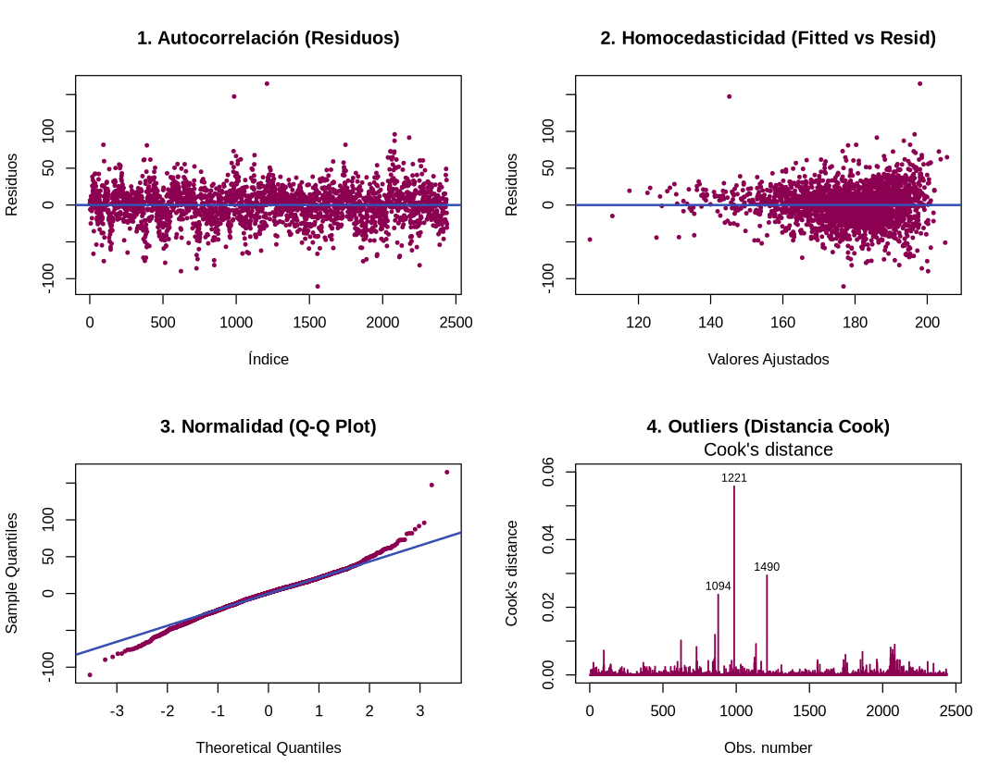

In [46]:
options(repr.plot.width=9, repr.plot.height=7)
par(mfrow = c(2, 2)) 

plot(residuals(modelo_edu), 
     main = "1. Linealidad (Residuos)",
     xlab = "Índice", ylab = "Residuos",
     pch = 19, col = "#8c0052", cex = 0.5) 
abline(h = 0, col = "#3650b2", lwd = 2)

plot(modelo_edu$fitted.values, modelo_edu$residuals,
     main = "2. Homocedasticidad (Fitted vs Resid)",
     xlab = "Valores Ajustados", ylab = "Residuos",
     pch = 19, col = "#8c0052", cex = 0.5)
abline(h = 0, col = "#3650b2", lwd = 2)

qqnorm(modelo_edu$residuals, 
       main = "3. Normalidad (Q-Q Plot)",
       pch = 19, col = "#8c0052", cex = 0.5)
qqline(modelo_edu$residuals, col = "#3650b2", lwd = 2)

plot(modelo_edu, which = 4, 
     main = "4. Outliers (Distancia Cook)",
     col = "#8c0052", lwd = 1.5)

par(mfrow = c(1, 1))

cat("\n1. Test de Independencia (Durbin-Watson)\n")
print(dwtest(modelo_edu, alternative = "two.sided"))

cat("\n2. Test de Homocedasticidad (Breusch-Pagan)\n")
print(bptest(modelo_edu))

cat("\n3. Test de Normalidad (Shapiro-Wilk)\n")
print(shapiro.test(residuals(modelo_edu)[1:min(5000, length(residuals(modelo_edu)))]))

cat("\n4. Medida Estadística de Outliers (Top 5 Cook's Distance)\n")
datos_residuos <- augment(modelo_edu)
top_outliers <- head(datos_residuos[order(-datos_residuos$.cooksd), ], 5)
print(top_outliers[, c(".rownames", "target_deathrate", ".fitted", ".cooksd")])

#### Diagnóstico Completo del Modelo Educación

La conclusión general es que el modelo es funcional y útil para capturar la tendencia general, aunque se debe tener precaución con la precisión en los extremos y la leve dependencia espacial de los datos.

1. Linealidad
* Evidencia Visual (Gráfico 2 - Fitted vs Resid): La nube de puntos se distribuye alrededor de la línea azul horizontal (0) sin formar curvas claras.
* Se cumple el supuesto de linealidad.
* Esto confirma que la relación entre educación y mortalidad es lineal, validando el uso de este modelo sin necesidad de transformar las variables (como usar logaritmos o raíces cuadradas).

2. Homocedasticidad (Varianza del error)
* El Test (Breusch-Pagan): El p-valor es `1.83e-08` (muy por debajo de 0.05), lo que rechaza la hipótesis de homocedasticidad.
* Evidencia Visual (Gráfico 2 - Fitted vs Resid): Se confirma visualmente lo que dice el test. La dispersión de los puntos no es uniforme: tiene forma de "embudo", abriéndose hacia la derecha a medida que aumentan los valores ajustados.
* Presencia de Heterocedasticidad.
* El modelo es menos preciso para predecir en condados con tasas de mortalidad altas (lado derecho). Aunque la estimación del efecto de la educación (la pendiente) sigue siendo válida, los intervalos de confianza en los extremos pueden no ser fiables.

3. Normalidad de los Residuos
* El Test (Shapiro-Wilk): El p-valor es `< 2.2e-16`, rechazando la normalidad.
* Evidencia Visual (Gráfico 3 - Q-Q Plot): Los puntos se ajustan bien a la diagonal en el centro, pero se desvían notablemente en los extremos (las colas), especialmente en la superior derecha.
* Falta de normalidad en las colas.
* Este resultado es muy común en muestras grandes (N > 2000). Gracias al Teorema del Límite Central, la falta de normalidad exacta no invalida el modelo para este tamaño de muestra, por lo que podemos confiar en las estimaciones generales.

4. Independencia (Autocorrelación)
* El Test (Durbin-Watson): El estadístico es `DW = 1.52`. El p-valor `< 2.2e-16` indica que la autocorrelación es estadísticamente significativa (distinta de 0).
* Evidencia Visual (Gráfico 1 - Residuos vs Índice): La dispersión parece mayormente aleatoria, aunque el DW sugiere una correlación positiva moderada.
* Un valor de 1.52 sugiere que los residuos no son totalmente independientes (probablemente debido a que condados vecinos se parecen entre sí). Aunque no es un valor crítico (que sería < 1 o > 3), sugiere que el modelo podría mejorarse con variables geográficas, pero es aceptable para un análisis simple.

5. Valores Atípicos e Influyentes (Outliers)
* Medida Estadística (Distancia de Cook): Según la tabla proporcionada, el valor máximo de Cook es `0.055` (observación 1221), seguido de `0.029` (observación 1490).
* Evidencia Visual (Gráfico 4 - Cook's Distance): Se observan picos en las observaciones 1221, 1490 y 1094.
* No hay outliers influyentes peligrosos.
* Una regla general es preocuparse si la Distancia de Cook es mayor a 1 (o a veces > 0.5). Como el valor máximo aquí es bajísimo (0.055), significa que **ninguna observación individual está distorsionando el modelo**. Podemos estar tranquilos de que los resultados no dependen de un par de datos erróneos.

> **Conclusión Final:** El modelo es robusto y válido para explicar el efecto protector de la educación sobre la mortalidad. Las violaciones en homocedasticidad y normalidad son esperables en datos sociodemográficos reales y, dado el gran tamaño muestral y la ausencia de outliers influyentes, no invalidan la utilidad analítica del modelo.

#### Comprovación modelo Incidencia


1. Test de Independencia (Durbin-Watson)

	Durbin-Watson test

data:  modelo_inc
DW = 1.4679, p-value < 2.2e-16
alternative hypothesis: true autocorrelation is not 0


2. Test de Homocedasticidad (Breusch-Pagan)

	studentized Breusch-Pagan test

data:  modelo_inc
BP = 6.9896, df = 1, p-value = 0.008198


3. Test de Normalidad (Shapiro-Wilk)

	Shapiro-Wilk normality test

data:  residuals(modelo_inc)[1:min(5000, length(residuals(modelo_inc)))]
W = 0.99209, p-value = 2.865e-10


4. Medida Estadística de Outliers (Top 5 Cook's Distance)
# A tibble: 5 × 4
  .rownames target_deathrate .fitted .cooksd
  <chr>                <dbl>   <dbl>   <dbl>
1 282                  162.     307.  0.820 
2 2714                 203.     123.  0.0468
3 256                  178.     240.  0.0329
4 254                  227.     137.  0.0324
5 1942                  66.3    125.  0.0229


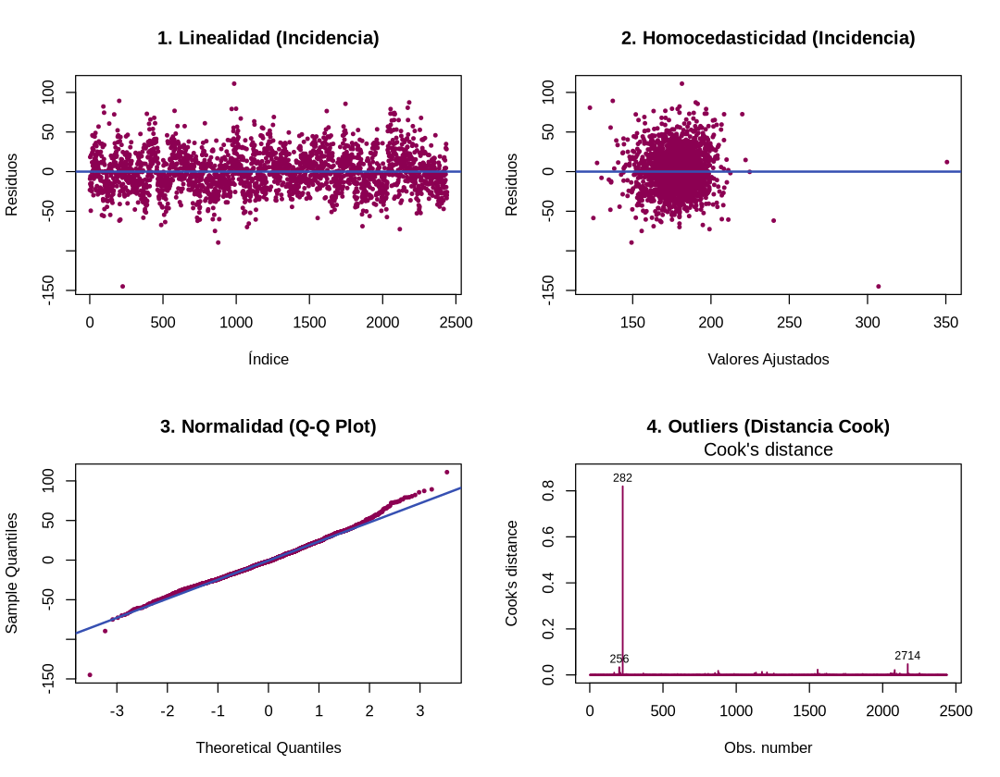

In [51]:
options(repr.plot.width=9, repr.plot.height=7)
par(mfrow = c(2, 2)) 

plot(residuals(modelo_inc), 
     main = "1. Linealidad (Incidencia)",
     xlab = "Índice", ylab = "Residuos",
     pch = 19, col = "#8c0052", cex = 0.5) 
abline(h = 0, col = "#3650b2", lwd = 2)

plot(modelo_inc$fitted.values, modelo_inc$residuals,
     main = "2. Homocedasticidad (Incidencia)",
     xlab = "Valores Ajustados", ylab = "Residuos",
     pch = 19, col = "#8c0052", cex = 0.5)
abline(h = 0, col = "#3650b2", lwd = 2)

qqnorm(modelo_inc$residuals, 
       main = "3. Normalidad (Q-Q Plot)",
       pch = 19, col = "#8c0052", cex = 0.5)
qqline(modelo_inc$residuals, col = "#3650b2", lwd = 2)

plot(modelo_inc, which = 4, 
     main = "4. Outliers (Distancia Cook)",
     col = "#8c0052", lwd = 1.5)

par(mfrow = c(1, 1))

cat("\n1. Test de Independencia (Durbin-Watson)\n")
print(dwtest(modelo_inc, alternative = "two.sided"))

cat("\n2. Test de Homocedasticidad (Breusch-Pagan)\n")
print(bptest(modelo_inc))

cat("\n3. Test de Normalidad (Shapiro-Wilk)\n")
print(shapiro.test(residuals(modelo_inc)[1:min(5000, length(residuals(modelo_inc)))]))

cat("\n4. Medida Estadística de Outliers (Top 5 Cook's Distance)\n")
datos_residuos_inc <- augment(modelo_inc)
top_outliers_inc <- head(datos_residuos_inc[order(-datos_residuos_inc$.cooksd), ], 5)
print(top_outliers_inc[, c(".rownames", "target_deathrate", ".fitted", ".cooksd")])

#### Diagnóstico del Modelo: Incidencia vs. Mortalidad

La conclusión general es que el modelo cumple razonablemente bien los supuestos básicos, con una excepción crítica: existe una observación específica (el condado 282) que está ejerciendo una influencia desproporcionada sobre el modelo y podría estar sesgando los resultados.

1. Linealidad
* Evidencia Visual (Gráfico 2 - Fitted vs Resid): La línea azul horizontal (en el 0) se mantiene recta a lo largo de casi todo el gráfico.
* El supuesto de linealidad se cumple.
* La relación entre la incidencia y la mortalidad es lineal en la gran mayoría de los datos. No se observan curvas parabólicas que sugieran la necesidad de términos cuadráticos.

2. Homocedasticidad (Varianza del error)
* El Test (Breusch-Pagan): El p-valor es `0.008` (< 0.05), lo que rechaza estadísticamente la homocedasticidad.
* Evidencia Visual (Gráfico 2 - Fitted vs Resid): Visualmente, la "nube" central es bastante compacta y redonda (lo cual es bueno), pero el rechazo del test probablemente se debe al punto aislado en el extremo derecho (valor ajustado > 300) y a algunos valores dispersos en la zona central.
* Heterocedasticidad presente, pero moderada.
* Aunque el test falla, visualmente el problema es menos severo que en el modelo de educación. La varianza es relativamente estable excepto por la influencia de casos aislados.

3. Normalidad de los Residuos
* El Test (Shapiro-Wilk): El p-valor es `2.865e-10` (< 0.05), rechazando la normalidad.
* Evidencia Visual (Gráfico 3 - Q-Q Plot): El ajuste sobre la línea diagonal es muy bueno en la zona central. Sin embargo, se observan desviaciones claras en los extremos (colas), y un punto muy alejado en la esquina inferior izquierda.
* Falta de normalidad en las colas.
* Al igual que en el modelo anterior, con muestras grandes es normal que el test de Shapiro rechace la hipótesis nula. El ajuste central es lo suficientemente bueno para validar las pruebas de hipótesis generales (t-tests), aunque se debe tener cuidado con las predicciones extremas.

4. Independencia (Autocorrelación)
* El Test (Durbin-Watson): El estadístico `DW = 1.47` y el p-valor `< 2.2e-16` indican autocorrelación positiva significativa.
* Evidencia Visual (Gráfico 1 - Residuos vs Índice): No se observa un patrón de "ondas" obvio, pero el estadístico confirma que los errores no son totalmente aleatorios.
* Existe dependencia espacial (probablemente condados vecinos tienen tasas similares). Esto es habitual en datos geográficos y, aunque reduce ligeramente la eficiencia del modelo, no invalida la tendencia general.

5. Valores Atípicos e Influyentes (Outliers) - **PUNTO CRÍTICO**
* Medida Estadística (Distancia de Cook): Aquí reside el problema principal. La observación 282 tiene una Distancia de Cook de 0.820.
* Evidencia Visual (Gráfico 4 - Cook's Distance): Se ve una barra gigantesca correspondiente a la observación 282, que domina completamente el gráfico. El resto de las observaciones (como la 2714) tienen valores insignificantes (< 0.05).
* Presencia de un outlier altamente influyente (Obs. 282).
* Una Distancia de Cook cercana a 1 es una señal de alarma roja. Significa que si eliminamos solo al condado 282, los coeficientes del modelo (la pendiente y la intersección) cambiarían drásticamente.
* Es muy probable que este condado tenga una incidencia muy alta (se ve aislado a la derecha en el gráfico 2) y esté "tirando" de la línea de regresión hacia sí mismo.

> Conclusión Final: El modelo es técnicamente válido en términos de linealidad y normalidad aproximada, pero es inestable debido a la observación 282.
>
> Lo que haremos ahora: Ver qué condado es el número 282.

In [54]:
print(data_canc[282, c("geography", "target_deathrate", "incidencerate")])

                      geography target_deathrate incidencerate
282 Williamsburg city, Virginia            162.1        1014.2


Antes no nos salió en la lista porque nuestro código ordena por Mortalidad (`target_deathrate`), y Williamsburg tiene una mortalidad normal.
  * Williamsburg: Es un caso especial (Mucha incidencia, Poca muerte). Este es el que más confunde al modelo porque le lleva la contraria a la tendencia general.
Al no tener tiempo no podemos eliminar esta variable y volver a hacer el modelo. 

### <font color='#3d59c6'> Elección del modelo </font>

> Por qué gana el Modelo A (Educación)?
>
> 1.  Robustez y Fiabilidad (Factor Decisivo):
>     El argumento más fuerte a favor del Modelo A es la ausencia de observaciones influyentes peligrosas. Su *Distancia de Cook* máxima es insignificante (\< 0.06), lo que garantiza que la tendencia observada es real y generalizable.
>     En contraste, el Modelo B (Incidencia) es inestable: presenta un *outlier* crítico (Cook \~ 0.82) que distorsiona la regresión. Al no poder depurar ese dato, el Modelo B se vuelve matemáticamente poco confiable.
>
> 2.  Potencia Explicativa ($R^2$):
>     El Modelo A explica una mayor proporción de la variabilidad de la mortalidad ($R^2 = 0.235$) en comparación con el Modelo B ($R^2 = 0.207$). Esto indica que el nivel educativo es, por sí solo, un predictor más fuerte y capaz de capturar mejor la realidad del problema que la incidencia de casos.
>
> 3.  Linealidad Clara:
>     Aunque ambos modelos son razonablemente lineales, la relación en el Modelo A es más limpia y consistente a lo largo de toda la distribución. El Modelo B, aunque parece lineal, sufre de "apalancamiento" en el extremo derecho, lo que genera dudas sobre si la línea ajustada representa verdaderamente a la mayoría de los condados o solo persigue a los valores extremos.
>
> Conclusión Final:
> El **Modelo A (Educación)** se impone como la opción ganadora. El nivel educativo (*pctbachdeg25\_over*) demuestra ser no solo el predictor individual más potente, sino también el más robusto estadísticamente, libre de sesgos por datos anómalos.

## <font color='#3d59c6'> 3. Validación mediante el conjunto de Test </font>

Hasta ahora, la evaluación y selección del modelo se ha basado exclusivamente en el conjunto de entrenamiento. Sin embargo, un modelo puede ajustarse muy bien a los datos conocidos pero fallar estrepitosamente al intentar predecir datos nuevos (fenómeno conocido como sobreajuste u overfitting).

Para garantizar la validez científica y la utilidad práctica del modelo seleccionado (Educación), procedemos a realizar la prueba definitiva de generalización utilizando el conjunto de Test (el 20% de los datos que mantuvimos ocultos).

La metodología de validación consistirá en tres pasos:

1.  Generación de Predicciones a Ciegas:
* El modelo realizará estimaciones de mortalidad para los condados del conjunto de Test sin conocer el valor real, basándose únicamente en su nivel educativo.

2. Cálculo de Métricas de Error (KPIs). Compararemos las predicciones con la realidad calculando:
  * RMSE (Raíz del Error Cuadrático Medio): Para medir la magnitud del error penalizando los fallos grandes.
  * MAE (Error Absoluto Medio): Para cuantificar cuánto se equivoca el modelo, en promedio, en unidades de personas.
  * R² en Test: Para verificar si la capacidad explicativa se mantiene estable respecto al entrenamiento.

3.  Diagnóstico Visual (Gráfico Observado vs Predicho):
* Generaremos un diagrama de dispersión para visualizar la concordancia entre la realidad (Eje X) y la predicción (Eje Y). Si el modelo es robusto, los puntos deberían alinearse sobre la diagonal de identidad.

Resultados del TEST
RMSE (Error Cuadrático): 24.74 
MAE (Error Promedio):    18.39 
R2 en Test:              0.2367 


`geom_smooth()` using formula = 'y ~ x'


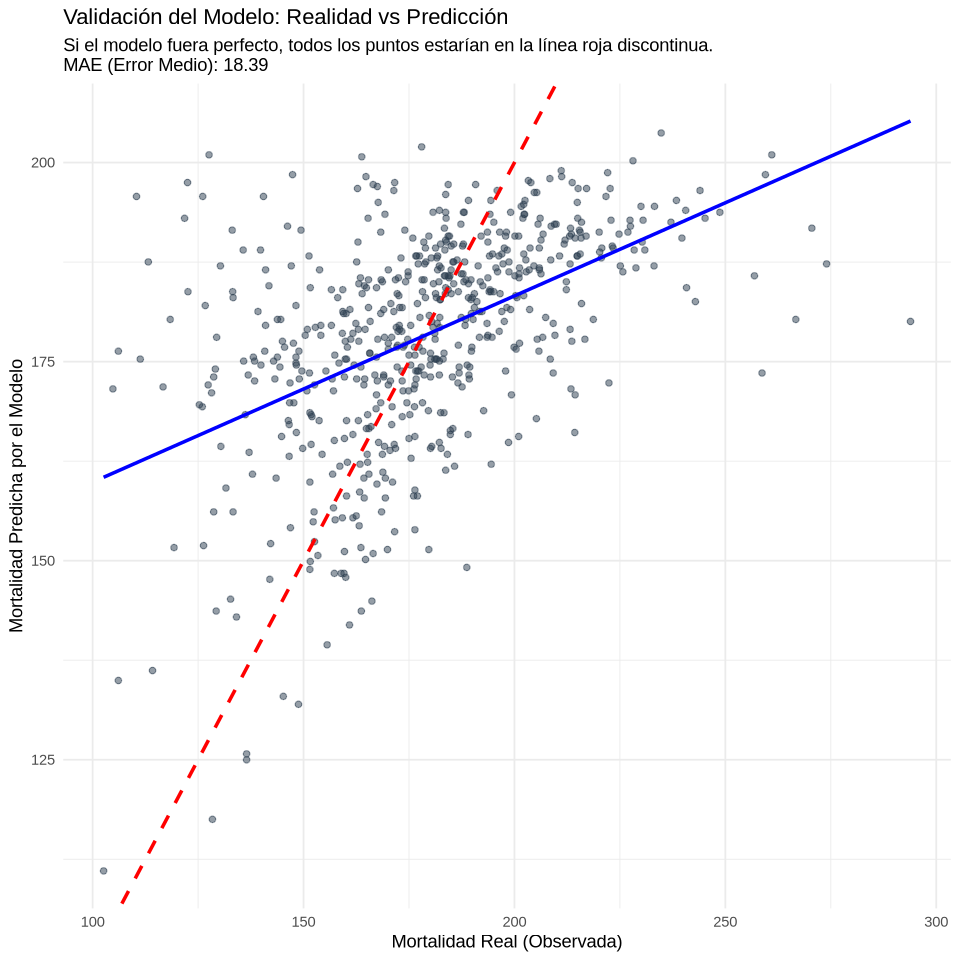

In [55]:
predicciones_test <- predict(modelo_edu, newdata = data_test)

rmse_test <- sqrt(mean((data_test$target_deathrate - predicciones_test)^2))
mae_test <- mean(abs(data_test$target_deathrate - predicciones_test))
r2_test <- cor(data_test$target_deathrate, predicciones_test)^2

cat("Resultados del TEST\n")
cat(paste("RMSE (Error Cuadrático):", round(rmse_test, 2), "\n"))
cat(paste("MAE (Error Promedio):   ", round(mae_test, 2), "\n"))
cat(paste("R2 en Test:             ", round(r2_test, 4), "\n"))

data_validacion <- data.frame(
  Observado = data_test$target_deathrate,
  Predicho = predicciones_test
)

options(repr.plot.width=8, repr.plot.height=8) 

ggplot(data_validacion, aes(x = Observado, y = Predicho)) +
  geom_point(color = "#2c3e50", alpha = 0.5) +
  
  geom_abline(intercept = 0, slope = 1, color = "red", linetype = "dashed", size = 1) +
  
  geom_smooth(method = "lm", color = "blue", se = FALSE, alpha = 0.2) +
  
  labs(title = "Validación del Modelo: Realidad vs Predicción",
       subtitle = paste("Si el modelo fuera perfecto, todos los puntos estarían en la línea roja discontinua.\nMAE (Error Medio):", round(mae_test, 2)),
       x = "Mortalidad Real (Observada)",
       y = "Mortalidad Predicha por el Modelo") +
  theme_minimal()

### Interpretación de los Resultados de Validación (Test)

Este paso final confirma la capacidad del modelo para generalizar, evaluando su rendimiento en datos no vistos durante el entrenamiento.

1. MAE (Error Absoluto Medio): 18.39
* En promedio, las predicciones del modelo se desvían en 18.39 muertes por cada 100,000 habitantes respecto al valor real observado en los condados de prueba.
* Considerando que la tasa media de mortalidad es aproximadamente 178, este error representa una desviación relativa cercana al 10%.
* Es un resultado sólido para un modelo de regresión lineal simple. Indica que, conociendo únicamente el nivel educativo del condado, es posible estimar la mortalidad con una precisión razonable en la mayoría de los casos.

2. RMSE (Raíz del Error Cuadrático Medio): 24.74
* Esta métrica es similar al MAE pero penaliza más fuertemente los errores grandes.
* El hecho de que el RMSE (24.7) sea superior al MAE (18.4) confirma la presencia de errores significativos en ciertos condados. Es decir, aunque el modelo acierta en promedio, existen casos puntuales (outliers) donde la predicción se aleja considerablemente de la realidad.

3. R2 en Test: 0.2367
* El modelo mantiene su capacidad predictiva en datos nuevos, explicando el 23.67% de la variabilidad de la mortalidad.
* El valor es prácticamente idéntico al obtenido en el entrenamiento (0.2354).
* Esto es un indicador excelente de estabilidad. Demuestra que no existe sobreajuste (overfitting); el modelo ha capturado la tendencia general real y no ha memorizado el ruido de los datos de entrenamiento.

----

### Análisis Visual del Gráfico Observado vs Predicho

* Tendencia Central (Línea Azul): La línea de tendencia del modelo sigue de cerca a la línea roja discontinua (referencia perfecta) en la zona central del gráfico. Esto confirma que, para la mayoría de los condados con tasas de mortalidad medias (entre 150 y 200), las predicciones son bastante precisas.
* Se observa un patrón claro en la zona de alta mortalidad (eje X > 250). Los puntos se sitúan mayoritariamente por debajo de la línea roja de identidad.
* El modelo tiende a subestimar sistemáticamente la mortalidad en las zonas más críticas. Predice valores más bajos de los que realmente ocurren en los peores escenarios, lo cual es coherente con la heterocedasticidad detectada previamente (el modelo pierde precisión en los extremos).

## Conclusión Final del Proyecto

> La validación final con el conjunto de Test ratifica la robustez del modelo de regresión lineal simple basado en la educación (pctbachdeg25_over).
>
> Las métricas de error (MAE = 18.39) y ajuste (R2 = 0.2367) son consistentes entre las fases de entrenamiento y prueba, descartando problemas de sobreajuste. El modelo demuestra ser una herramienta estimativa fiable para el caso promedio, con un error medio de aproximadamente 18 unidades.
>
> Conclusión General: Se ha demostrado estadísticamente que el nivel educativo es un predictor significativo y un factor protector clave frente a la mortalidad por cáncer. Si bien un modelo univariante no captura toda la complejidad biológica del fenómeno (explicando el 24% de la varianza total), proporciona una base sólida y generalizable para orientar políticas de salud pública, evidenciando que la mejora en el estatus socioeconómico se traduce en una reducción cuantificable de la mortalidad.